In [ ]:
import os, sys
import json
import numpy as np
from google.colab import drive

import sklearn
from tqdm.notebook import tqdm
from collections import Counter
import itertools
import random

from random import choice


In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

Sun May 16 23:01:33 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    23W / 300W |      0MiB / 16160MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
drive.mount('/content/drive')
nb_path = '/content/notebooks' 
#os.symlink('/content/drive/My Drive/Colab Notebooks', nb_path)
sys.path.insert(0,nb_path)

Mounted at /content/drive


In [ ]:
#!cd /content/drive/MyDrive/nn_models; git clone https://github.com/Samsung-IT-Academy/stepik-dl-nlp.git 
!pip install -r /content/drive/MyDrive/nn_models/stepik-dl-nlp/requirements.txt
import sys; sys.path.append('./stepik-dl-nlp')

     |████████████████████████████████| 61kB 6.3MB/s 
     |████████████████████████████████| 1.7MB 28.7MB/s 
     |████████████████████████████████| 24.2MB 1.5MB/s 
     |████████████████████████████████| 307kB 47.5MB/s 
     |████████████████████████████████| 8.2MB 45.3MB/s 
  Created wheel for wget: filename=wget-3.2-cp37-none-any.whl size=9681 sha256=7a92a7d44e3286a935b1e32d10c702bbcd16dad9be0826ebec7b0c780777497b
  Stored in directory: /root/.cache/pip/wheels/40/15/30/7d8f7cea2902b4db79e3fea550d7d7b85ecb27ef992b618f3f
  Created wheel for ufal.udpipe: filename=ufal.udpipe-1.2.0.3-cp37-cp37m-linux_x86_64.whl size=5626606 sha256=c8db15112b0ac05b318cb4e110937c619907856ab444eba9e022e6adf7cc6c97
  Stored in directory: /root/.cache/pip/wheels/0c/9d/db/6d3404c33da5b7adb6c6972853efb6a27649d3ba15f7e9bebb
  Created wheel for intervaltree: filename=intervaltree-3.1.0-py2.py3-none-any.whl size=26102 sha256=b6c5927ee1b9b272c34c925f26a5d46df34e03baeb72c084d892ad4e4fda210e
  Stored in directory: 

# Загрузим данные

In [ ]:
data_folder = '/content/drive/MyDrive/Datasets/NREL/task2'
with open(os.path.join(data_folder, 'train.json'), 'r') as f:
  train_data = json.load(f)
with open(os.path.join(data_folder, 'dev.json'), 'r') as f:
  dev_data = json.load(f)
with open(os.path.join(data_folder, 'test.json'), 'r') as f:
  test_data = json.load(f)

In [ ]:
ex = choice(train_data)
ex

{'cover': 'МВД Украины',
 'cover_type': 'ORGANIZATION',
 'file': '113790_text',
 'obj': 'Украины',
 'obj_type': 'COUNTRY',
 'rel': 'HEADQUARTERED_IN',
 'subj': 'МВД Украины',
 'subj_type': 'ORGANIZATION'}

# Препроцессинг

In [ ]:
!pip install natasha
!pip install pymorphy2
!pip install pymorphy2-dicts
!pip install DAWG-Python

from razdel import tokenize


     |████████████████████████████████| 34.4MB 148kB/s 
     |████████████████████████████████| 51kB 8.0MB/s 
     |████████████████████████████████| 51kB 8.4MB/s 
     |████████████████████████████████| 7.1MB 9.9MB/s 


## FastText вектора

In [ ]:
import gensim 

In [ ]:
model_path = '/content/drive/MyDrive/nn_models/fasttext/'
fasttext_file = '/content/drive/MyDrive/nn_models/fasttext/datasets/187/model.model'
w2v_model = gensim.models.KeyedVectors.load(fasttext_file)

In [ ]:
w2v_model.most_similar(positive=['палата парламента'], topn=10)

[('парламент', 0.7590026259422302),
 ('парламентарий', 0.7522000074386597),
 ('парламентёр', 0.7465718388557434),
 ('парламентария', 0.7433876991271973),
 ('горпарламент', 0.7336677312850952),
 ('парламентер', 0.7230035066604614),
 ('европарламент', 0.6756746172904968),
 ('парламентарный', 0.6696600914001465),
 ('парламентаризм', 0.6620998382568359),
 ('парламентский', 0.6550174951553345)]

### Получим вектора(пока без типов сущностей)

In [ ]:
import pymorphy2
morph = pymorphy2.MorphAnalyzer()

In [ ]:
def convert2vec(words):
  embeddings = [w2v_model.get_vector(word) for word in words]
  return embeddings

# вход - Dict[subj,obj...]
# выход - subj_vec, obj_vec

def proc_words(words):
  tokens = [morph.parse(tok.text.lower())[0].normal_form 
          for tok in words]
  return tokens

def prepare_data(ex):
  subj_tokens = proc_words(list(tokenize(ex['subj'])))
  obj_tokens = proc_words(list(tokenize(ex['obj'])))

  subj_vecs = convert2vec(subj_tokens)
  obj_vecs = convert2vec(obj_tokens)
  
  # агрегируем
  agr_subj = np.mean(subj_vecs, axis=0)
  agr_obj = np.mean(obj_vecs, axis=0)
  return agr_subj, agr_obj

In [ ]:
train_vecs = [prepare_data(ex) for ex in train_data]
test_vecs = [prepare_data(ex) for ex in test_data]
dev_vecs = [prepare_data(ex) for ex in dev_data]

In [ ]:
# пока без типов сущностей


X_train = np.array([np.concatenate(vecs, axis = 0) for vecs in train_vecs])
X_dev = np.array([np.concatenate(vecs, axis = 0) for vecs in dev_vecs])
X_test = np.array([np.concatenate(vecs, axis = 0) for vecs in test_vecs])

#### Добавим типы сущностей

In [ ]:
from sklearn.preprocessing import OneHotEncoder

In [ ]:
train_subj = [[ex['subj_type']] for ex in train_data]
train_obj = [[ex['obj_type']] for ex in train_data]

dev_subj = [[ex['subj_type']] for ex in dev_data]
dev_obj = [[ex['obj_type']] for ex in dev_data]

test_subj = [[ex['subj_type']] for ex in test_data]
test_obj = [[ex['obj_type']] for ex in test_data]

In [ ]:
train_subj_l = [ex['subj_type'] for ex in train_data]
train_obj_l = [ex['obj_type'] for ex in train_data]

dev_subj_l = [ex['subj_type'] for ex in dev_data]
dev_obj_l = [ex['obj_type'] for ex in dev_data]

test_subj_l = [ex['subj_type'] for ex in test_data]
test_obj_l = [ex['obj_type'] for ex in test_data]

In [ ]:
all_types = set(train_subj_l)

In [ ]:
dict_type = {val:i for i, val in enumerate(all_types)}

In [ ]:
dict_type

{'AGE': 21,
 'AWARD': 25,
 'CITY': 17,
 'COUNTRY': 1,
 'CRIME': 12,
 'DATE': 6,
 'DISEASE': 5,
 'DISTRICT': 4,
 'EVENT': 27,
 'FACILITY': 13,
 'FAMILY': 8,
 'IDEOLOGY': 10,
 'LANGUAGE': 7,
 'LAW': 22,
 'LOCATION': 0,
 'MONEY': 9,
 'NATIONALITY': 15,
 'NUMBER': 18,
 'ORDINAL': 26,
 'ORGANIZATION': 23,
 'PENALTY': 20,
 'PERSON': 3,
 'PRODUCT': 14,
 'PROFESSION': 16,
 'RELIGION': 24,
 'STATE_OR_PROVINCE': 11,
 'TIME': 19,
 'WORK_OF_ART': 2}

In [ ]:
train_subj0 = np.array([np.array([dict_type[ex]]) for ex in train_subj_l])
train_obj0 = np.array([np.array([dict_type[ex]]) for ex in train_obj_l])

dev_subj0 = np.array([np.array([dict_type[ex]]) for ex in dev_subj_l])
dev_obj0 = np.array([np.array([dict_type[ex]]) for ex in dev_obj_l])

test_subj0 = np.array([np.array([dict_type[ex]]) for ex in test_subj_l])
test_obj0 = np.array([np.array([dict_type[ex]]) for ex in test_obj_l])

In [ ]:
ohe_enc = OneHotEncoder(sparse=False)
ohe_enc.fit(train_subj + train_obj)

train_subj_o = ohe_enc.transform(train_subj)
train_obj_o = ohe_enc.transform(train_obj)

dev_subj_o = ohe_enc.transform(dev_subj)
dev_obj_o = ohe_enc.transform(dev_obj)

test_subj_o = ohe_enc.transform(test_subj)
test_obj_o = ohe_enc.transform(test_obj)

In [ ]:
ohe_enc.categories_

[array(['AGE', 'AWARD', 'CITY', 'COUNTRY', 'CRIME', 'DATE', 'DISEASE',
        'DISTRICT', 'EVENT', 'FACILITY', 'FAMILY', 'IDEOLOGY', 'LANGUAGE',
        'LAW', 'LOCATION', 'MONEY', 'NATIONALITY', 'NUMBER', 'ORDINAL',
        'ORGANIZATION', 'PENALTY', 'PERSON', 'PRODUCT', 'PROFESSION',
        'RELIGION', 'STATE_OR_PROVINCE', 'TIME', 'WORK_OF_ART'],
       dtype=object)]

In [ ]:
## вместе с типами сущностей(сконкатенированные)
X_train1 = np.concatenate((X_train, train_subj_o, train_obj_o), axis = 1)
X_dev1 = np.concatenate((X_dev, dev_subj_o, dev_obj_o), axis = 1)
X_test1 = np.concatenate((X_test, test_subj_o, test_obj_o), axis = 1)

### Вектора таргетов

In [ ]:
# labels

rels_train = [ex['rel'] for ex in train_data]
rels_dev = [ex['rel'] for ex in dev_data]
rels_test = [ex['rel'] for ex in test_data]

In [ ]:
from sklearn.preprocessing import LabelEncoder

In [ ]:
labelEnc = LabelEncoder()
labelEnc.fit(y=rels_train + rels_dev)
y_train = labelEnc.transform(rels_train)
y_dev = labelEnc.transform(y=rels_dev)
y_test = labelEnc.transform(y=rels_test)

In [ ]:
num_relations = len(labelEnc.classes_)
print('Число отношений: ', num_relations)

Число отношений:  36


In [ ]:
all_labels = set(labelEnc.classes_) - {'no_relation'}
all_labels

{'ABBREVIATION',
 'AGENT',
 'AGE_IS',
 'ALTERNATIVE_NAME',
 'DATE_FOUNDED_IN',
 'DATE_OF_BIRTH',
 'DATE_OF_CREATION',
 'END_TIME',
 'FOUNDED_BY',
 'HAS_CAUSE',
 'HEADQUARTERED_IN',
 'IDEOLOGY_OF',
 'INANIMATE_INVOLVED',
 'LOCATED_IN',
 'MEMBER_OF',
 'ORGANIZES',
 'ORIGINS_FROM',
 'OWNER_OF',
 'PARENT_OF',
 'PARTICIPANT_IN',
 'PART_OF',
 'PLACE_RESIDES_IN',
 'POINT_IN_TIME',
 'PRICE_OF',
 'PRODUCES',
 'RELATIVE',
 'RELIGION_OF',
 'SIBLING',
 'SPOUSE',
 'START_TIME',
 'SUBEVENT_OF',
 'SUBORDINATE_OF',
 'TAKES_PLACE_IN',
 'WORKPLACE',
 'WORKS_AS'}

## Дополнительно


### Зададим веса классов

In [ ]:
# id класса no_relation
print('id of no_relation - ', labelEnc.transform(['no_relation']))
print(len(labelEnc.classes_))

id of no_relation -  [35]
36


In [ ]:
class_weights = {i: 1 for i in range(35)}
class_weights[35] = 0.5
class_weights

{0: 1,
 1: 1,
 2: 1,
 3: 1,
 4: 1,
 5: 1,
 6: 1,
 7: 1,
 8: 1,
 9: 1,
 10: 1,
 11: 1,
 12: 1,
 13: 1,
 14: 1,
 15: 1,
 16: 1,
 17: 1,
 18: 1,
 19: 1,
 20: 1,
 21: 1,
 22: 1,
 23: 1,
 24: 1,
 25: 1,
 26: 1,
 27: 1,
 28: 1,
 29: 1,
 30: 1,
 31: 1,
 32: 1,
 33: 1,
 34: 1,
 35: 0.5}

In [ ]:
from sklearn.utils import class_weight
y_tr_dev = np.concatenate((y_train, y_dev), axis=0)
class_weights_sklearn = class_weight.compute_class_weight('balanced',
                                                 np.unique(y_tr_dev),
                                                 y_tr_dev)

In [ ]:
class_weight1 = {i:round(val, 3) for i,val in enumerate(class_weights_sklearn)}

### С доп признаками 

In [ ]:
def convert2vec(words):
  embeddings = [w2v_model.get_vector(word) for word in words]
  return embeddings

# вход - Dict[subj,obj...]
# выход - subj_vec, obj_vec

def proc_words(words):
  tokens = [morph.parse(tok.text.lower())[0].normal_form 
          for tok in words]
  return tokens

def prepare_data2(ex):
  subj_vec = w2v_model.get_vector(ex['subj'].lower())
  obj_vec = w2v_model.get_vector(ex['obj'].lower())
  
  return subj_vec, obj_vec

In [ ]:
X_train2 = np.array([np.concatenate(prepare_data2(ex)) for ex in train_data])
X_dev2 = np.array([np.concatenate(prepare_data2(ex)) for ex in dev_data])
X_test2 = np.array([np.concatenate(prepare_data2(ex)) for ex in test_data])

In [ ]:
cross_train = np.array([int((ex['subj'] in ex['obj']) or (ex['obj'] in ex['subj'])) for ex in train_data])
cross_dev = np.array([int((ex['subj'] in ex['obj']) or (ex['obj'] in ex['subj'])) for ex in dev_data])
cross_test = np.array([int((ex['subj'] in ex['obj']) or (ex['obj'] in ex['subj'])) for ex in test_data])

In [ ]:
X_train3 = np.concatenate((X_train2,  np.expand_dims(cross_train, axis=1)), axis=1)
X_dev3 = np.concatenate((X_dev2,  np.expand_dims(cross_dev, axis=1)), axis=1)
X_test3 = np.concatenate((X_test2,  np.expand_dims(cross_test, axis=1)), axis=1)

In [ ]:
X_train4 = np.concatenate((X_train,  np.expand_dims(cross_train, axis=1)), axis=1)
X_dev4 = np.concatenate((X_dev,  np.expand_dims(cross_dev, axis=1)), axis=1)
X_test4 = np.concatenate((X_test,  np.expand_dims(cross_test, axis=1)), axis=1)

# Модели

In [ ]:
!pip install tensorflow-addons

     |████████████████████████████████| 706kB 4.4MB/s 


In [ ]:
import tensorflow_addons as tfa

### Prepare

In [ ]:
import tensorflow as tf
from tensorflow import keras

from tensorflow.keras.preprocessing import sequence
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, Activation,  Input, Add, Dot, Concatenate
from tensorflow.keras.layers import Embedding
from tensorflow.keras.layers import LSTM, GRU, SimpleRNN
from tensorflow.keras.layers import Convolution1D, MaxPooling1D
from tensorflow.keras.models import load_model


from keras.callbacks import LearningRateScheduler

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint
model_folder_path = '/content/drive/MyDrive/My_models/task2'

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

In [ ]:
def plot_confusion_matrix(y_true, y_pred, classes, normalize=False, title=None, cmap=plt.cm.Blues):
   
    cm     = confusion_matrix(y_true, y_pred, classes)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    
    fig, ax = plt.subplots(figsize=(10, 10))
    im      = ax.imshow(cm, interpolation='nearest', cmap=cmap)
   
    ax.figure.colorbar(im, ax=ax)
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           xticklabels=classes, 
           yticklabels=classes,
           title=title,
           ylabel='Истинный тэг',
           xlabel='Предсказанный тэг')
    
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",rotation_mode="anchor")

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt), ha="center", va="center", color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    
    return ax

def stat(y_true, y_predict):
  true_labels = [labelEnc.inverse_transform([y])[0] for y in y_true]
  predict_labels = [labelEnc.inverse_transform([y])[0] for y in y_predict]

  print(sklearn.metrics.classification_report(true_labels, predict_labels))
  f1_micro = round(sklearn.metrics.f1_score(true_labels, predict_labels, labels = list(all_labels), average = 'micro'), 4)
  f1_macro = round(sklearn.metrics.f1_score(true_labels, predict_labels, labels = list(all_labels), average = 'macro'), 4)

  print(f'Without no_relation class:\nf1_micro: {f1_micro}, f1_macro: {f1_macro}')

  plot_confusion_matrix(true_labels, predict_labels, classes=labelEnc.classes_ )

In [ ]:
from keras.callbacks import TensorBoard
import os
import tensorflow as tf
import datetime
%load_ext tensorboard
logdir = os.path.join('/content/drive/MyDrive/My_models/task2', "logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
%tensorboard --logdir '/content/drive/MyDrive/My_models/task2/logs/'

<IPython.core.display.Javascript object>

In [ ]:
keras.utils.plot_model(model, "multi_input_and_output_model.png", show_shapes=True)

In [ ]:
def show_train(history_DNN):
  plt.figure(figsize=(12, 5))
  plt.subplot(1,2,1)
  plt.title('Accuracy')
  plt.plot(history_DNN.history['accuracy'], 
          label='Train')
  plt.plot(history_DNN.history['val_accuracy'], 
          label='Validation')
  plt.xlabel('Epochs')
  plt.ylabel('Accuracy')
  plt.legend()
  plt.subplot(1,2,2)
  plt.title('Loss')
  plt.plot(history_DNN.history['loss'], label='loss')
  plt.plot(history_DNN.history['val_loss'], label='val_loss')
  plt.legend()
  plt.show()

## Попробуем svm

In [ ]:
from sklearn.svm import SVC

In [ ]:
svm = SVC()
svm.fit(X_train1, y_train)

SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.00      0.00      0.00         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       0.00      0.00      0.00         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.00      0.00      0.00         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.76      0.70      0.73       147
       IDEOLOGY_OF       0.67      0.60      0.63        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       1.00      0.29      0.44        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       1.00      0.19      0.32        53
          OWNER_OF       0.00      0.00

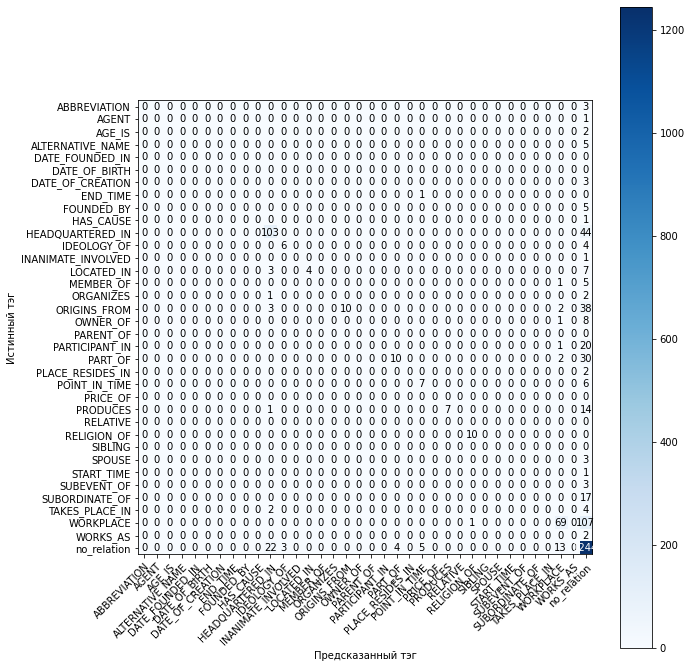

In [ ]:
svm_pred = svm.predict(X_test1)
stat(y_test, svm_pred)

## Модель 1: DNN с fasText эмбедингами, без типов сущностей

In [ ]:
# This is a sample of a scheduler I used in the past
def lr_scheduler(epoch, lr):
  #if epoch == 1:
  #  return start_lr
  decay_rate = 0.9
  decay_step = 7
  if epoch % decay_step == 0 and epoch:
      return lr * pow(decay_rate, np.floor(epoch / decay_step))
  return lr

def DNN1(feature_size, dropout=0.25):
    """
    buildModel_DNN_Tex(shape, nClasses,dropout)
    Build Deep neural networks Model for text classification
    Shape is input feature space
    nClasses is number of classes
    """
    model = Sequential()
    node = 512
    nLayers = 0
    
    model.add(Dense(node,input_dim=feature_size,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=1e-4, l2=1e-4),
              bias_regularizer=keras.regularizers.l2(1e-4),
              activity_regularizer=keras.regularizers.l2(1e-4)))
    model.add(Dropout(0.2))
    #model.add(Dense(128,input_dim=feature_size,activation='relu'))
    
    
    model.add(Dense(128,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=1e-5, l2=1e-5),
              bias_regularizer=keras.regularizers.l2(1e-5),
              activity_regularizer=keras.regularizers.l2(1e-5)))
    '''
    for i in range(0,nLayers):
        model.add(Dense(256,input_dim=node,activation='relu'))
        model.add(Dropout(dropout))
    '''
    model.add(Dense(num_relations, activation='softmax'))

    model.compile(loss='sparse_categorical_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy', 
                           #tfa.metrics.F1Score(average='micro', num_classes=num_relations-1)
                           ])

    return model

In [ ]:
model_DNN = DNN1(X_train.shape[1])

model_name = 'DNN1'
model_save_path = os.path.join(model_folder_path, model_name,'best_model.h5')
checkpoint_callback = ModelCheckpoint(model_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

history_DNN = model_DNN.fit(X_train, y_train,
                              validation_data=(X_dev, y_dev),
                              epochs=50,
                              batch_size=32,
                              callbacks=[LearningRateScheduler(lr_scheduler, verbose=1),
                                         tensorboard_callback,
                                         checkpoint_callback],
                              class_weight=class_weights,
                              verbose=2)

Epoch 1/50

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
461/461 - 2s - loss: 1.7887 - accuracy: 0.6813 - val_loss: 1.8790 - val_accuracy: 0.6921

Epoch 00001: val_accuracy improved from -inf to 0.69213, saving model to /content/drive/MyDrive/My_models/task2/DNN1/best_model.h5
Epoch 2/50

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
461/461 - 1s - loss: 1.2003 - accuracy: 0.7454 - val_loss: 1.3809 - val_accuracy: 0.7565

Epoch 00002: val_accuracy improved from 0.69213 to 0.75646, saving model to /content/drive/MyDrive/My_models/task2/DNN1/best_model.h5
Epoch 3/50

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
461/461 - 1s - loss: 0.9523 - accuracy: 0.7608 - val_loss: 1.3033 - val_accuracy: 0.7341

Epoch 00003: val_accuracy did not improve from 0.75646
Epoch 4/50

Epoch 00004: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
461/461 - 1s - loss: 0.837

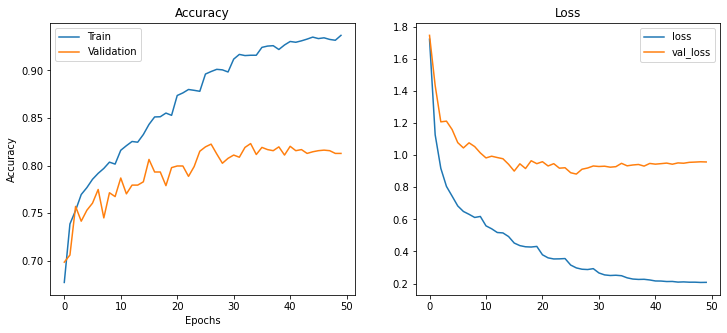

In [ ]:
#c dropout после первого слоя
show_train(history_DNN)

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.00      0.00      0.00         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.33      0.50         3
          END_TIME       1.00      1.00      1.00         1
        FOUNDED_BY       0.00      0.00      0.00         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.76      0.75      0.76       147
       IDEOLOGY_OF       0.88      0.70      0.78        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.64      0.50      0.56        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.77      0.38      0.51        53
          OWNER_OF       1.00      0.33

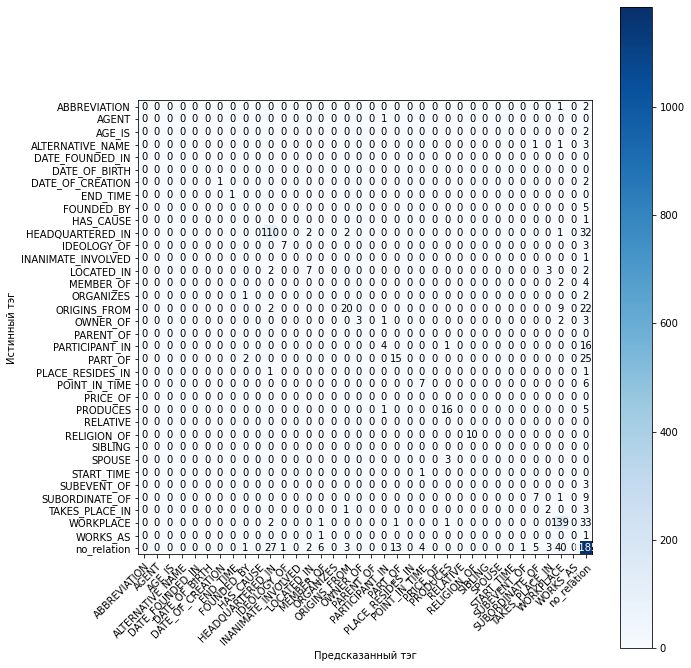

In [ ]:
# просто Dense + fastText без баланса
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict(X_test)
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.00      0.00      0.00         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.33      0.50         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.00      0.00      0.00         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.73      0.86      0.79       147
       IDEOLOGY_OF       0.77      1.00      0.87        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.62      0.36      0.45        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.71      0.45      0.55        53
          OWNER_OF       0.14      0.11

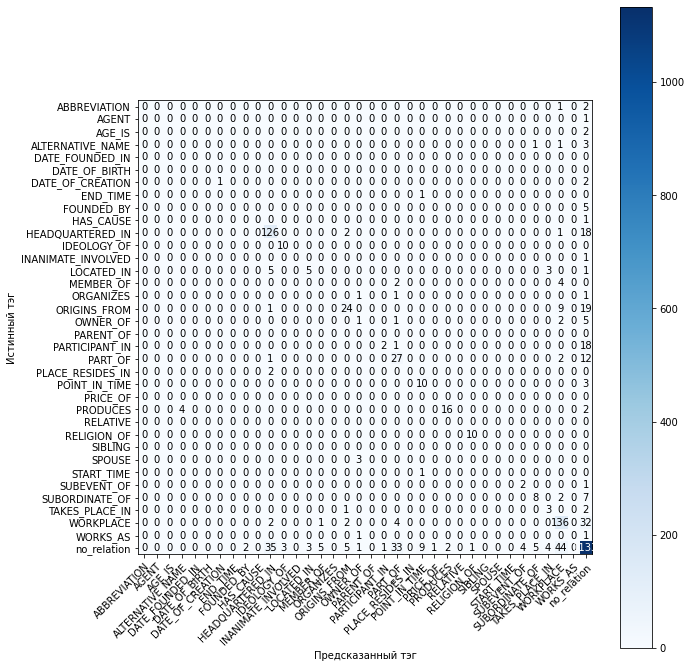

In [ ]:
# просто Dense + fastText с весом класса no_relation 0.5
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict(X_test)
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       1.00      0.50      0.67         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.33      0.50         3
          END_TIME       1.00      1.00      1.00         1
        FOUNDED_BY       0.11      0.20      0.14         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.68      0.87      0.76       147
       IDEOLOGY_OF       0.75      0.90      0.82        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.47      0.57      0.52        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.68      0.53      0.60        53
          OWNER_OF       0.14      0.11

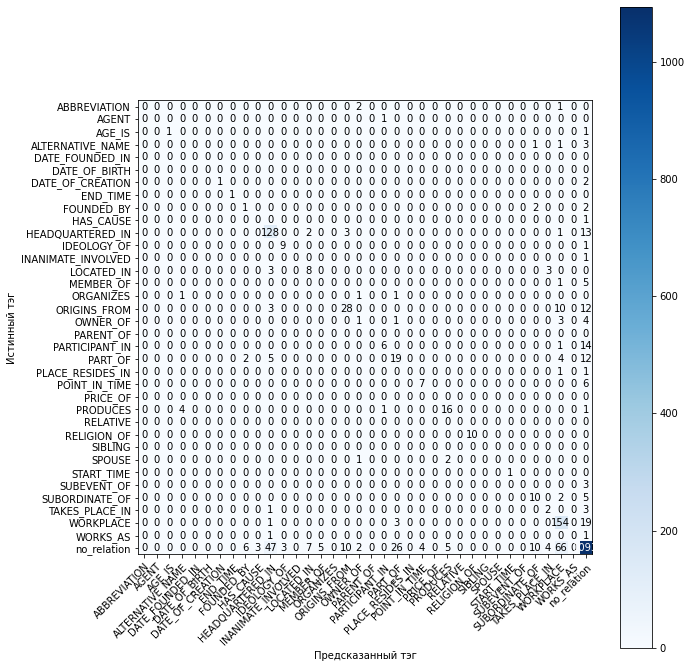

In [ ]:
# просто Dense + fastText с весом класса no_relation 0.3
# Хуже, чем 0.5
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict(X_test)
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       1.00      0.50      0.67         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       0.00      0.00      0.00         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.00      0.00      0.00         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.55      0.84      0.67       147
       IDEOLOGY_OF       0.67      1.00      0.80        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.33      0.50      0.40        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.56      0.42      0.48        53
          OWNER_OF       0.11      0.11

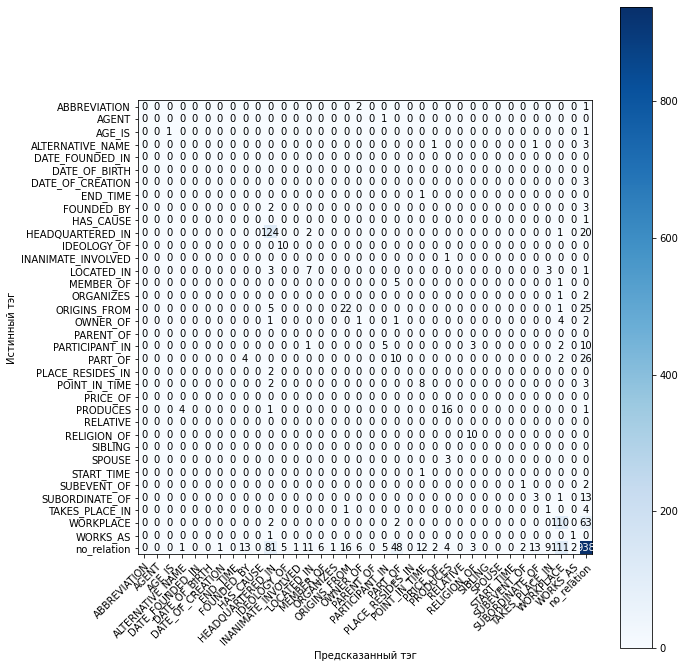

In [ ]:
# просто Dense + fastText сразу на softmax
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict(X_test)
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.50      0.50      0.50         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.33      0.50         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.33      0.60      0.43         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.72      0.80      0.76       147
       IDEOLOGY_OF       0.71      1.00      0.83        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.47      0.50      0.48        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.70      0.62      0.66        53
          OWNER_OF       0.20      0.22

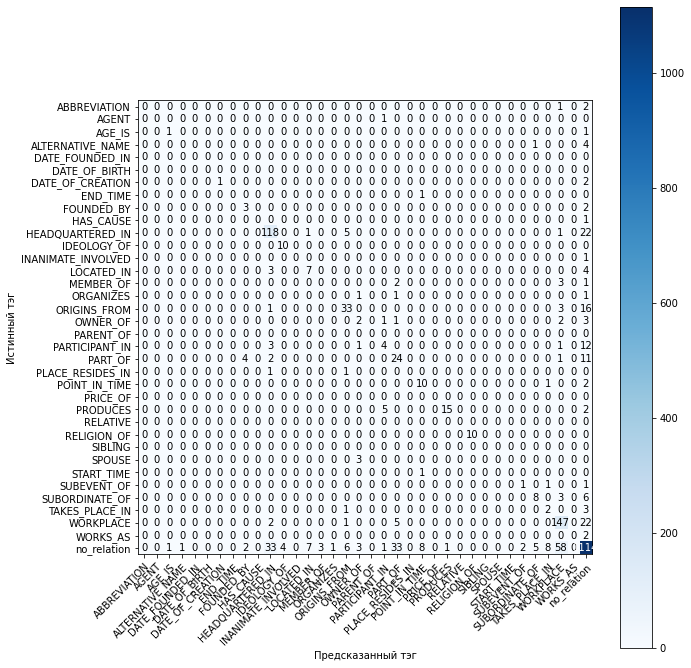

In [ ]:
# просто Dense + fastText + доп слой на 128
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict(X_test)
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.00      0.00      0.00         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.33      0.50         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.25      0.60      0.35         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.70      0.82      0.75       147
       IDEOLOGY_OF       0.67      1.00      0.80        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.45      0.36      0.40        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.65      0.62      0.63        53
          OWNER_OF       0.20      0.22

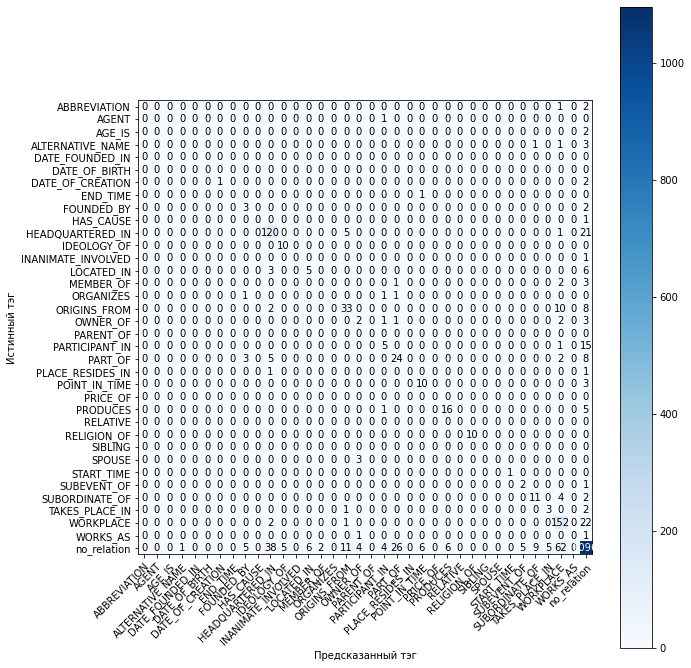

In [ ]:
# просто Dense + fastText + dropout после первого dense+  доп слой на 128
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict(X_test)
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       1.00      1.00      1.00         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.33      0.50         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.11      0.20      0.14         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.73      0.83      0.77       147
       IDEOLOGY_OF       0.71      1.00      0.83        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.53      0.57      0.55        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.63      0.49      0.55        53
          OWNER_OF       0.29      0.22

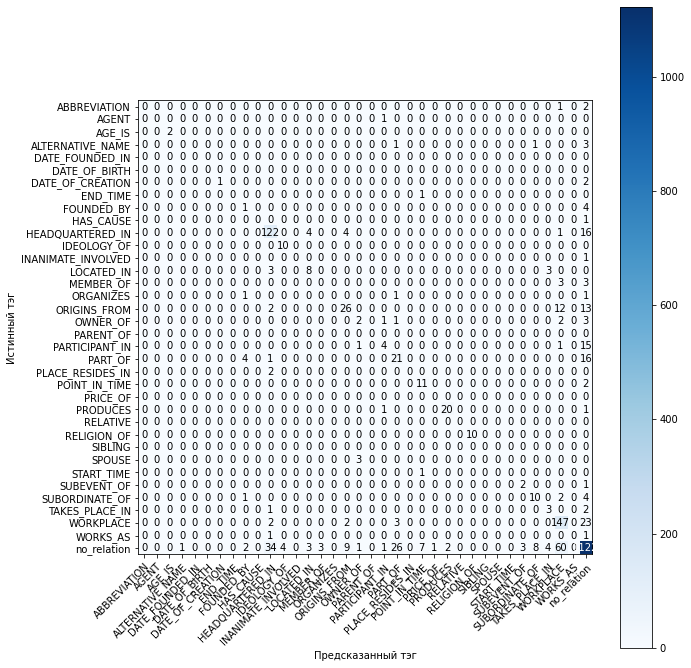

In [ ]:
# просто Dense + fastText + dropout после первого dense
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict(X_test)
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

#####  C балансом классов

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.00      0.00      0.00         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
   DATE_FOUNDED_IN       0.00      0.00      0.00         0
  DATE_OF_CREATION       1.00      0.33      0.50         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.14      0.80      0.24         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.57      0.87      0.69       147
       IDEOLOGY_OF       0.48      1.00      0.65        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.41      0.64      0.50        14
         MEMBER_OF       0.12      0.67      0.21         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.42      0.83

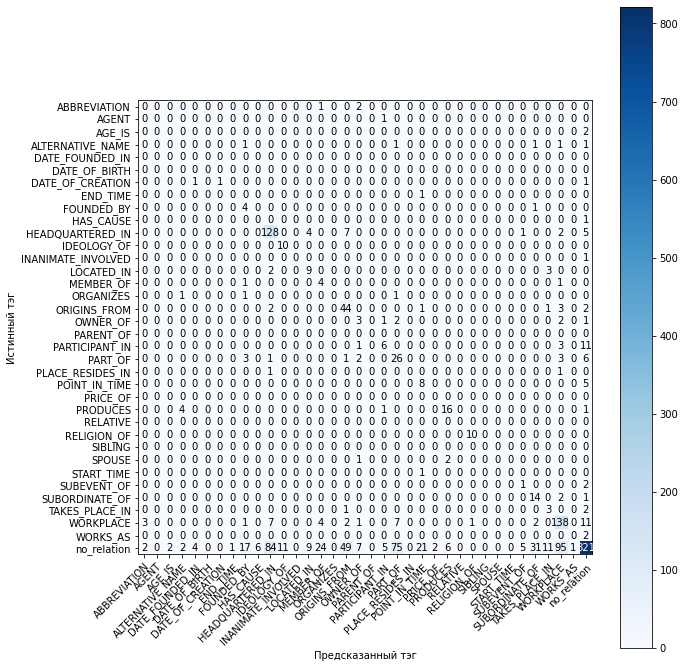

In [ ]:
# c балансом классов
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict(X_test)
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

#####  Занулили класс no_relation

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.20      0.50      0.29         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       0.22      0.67      0.33         3
          END_TIME       0.14      1.00      0.25         1
        FOUNDED_BY       0.04      0.60      0.08         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.46      0.96      0.63       147
       IDEOLOGY_OF       0.34      1.00      0.51        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.24      0.57      0.33        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.21      0.68      0.32        53
          OWNER_OF       0.10      0.33

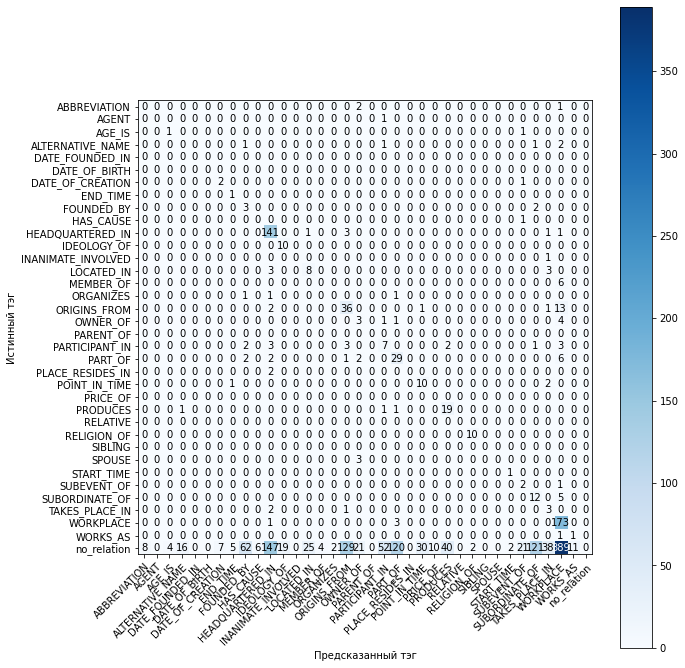

In [ ]:
# занулили класс no_relation

model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict(X_test)
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

#### Weight of no_relation = 0

In [ ]:
model_DNN = DNN1(X_train.shape[1])

model_name = 'DNN1'
model_save_path = os.path.join(model_folder_path, model_name,'best_model.h5')
checkpoint_callback = ModelCheckpoint(model_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

history_DNN = model_DNN.fit(X_train, y_train,
                              validation_data=(X_dev, y_dev),
                              epochs=30,
                              batch_size=16,
                              callbacks=[LearningRateScheduler(lr_scheduler, verbose=1),
                                         tensorboard_callback,
                                         checkpoint_callback],
                              class_weight=class_weights,
                              verbose=2)

Epoch 1/30

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 1.7289 - accuracy: 0.7230 - f1_score: 0.0555 - val_loss: 1.5415 - val_accuracy: 0.7530 - val_f1_score: 0.0555

Epoch 00001: val_accuracy improved from -inf to 0.75302, saving model to /content/drive/MyDrive/My_models/task2/DNN1/best_model.h5
Epoch 2/30

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 2s - loss: 1.0828 - accuracy: 0.7910 - f1_score: 0.0555 - val_loss: 1.2993 - val_accuracy: 0.7714 - val_f1_score: 0.0555

Epoch 00002: val_accuracy improved from 0.75302 to 0.77140, saving model to /content/drive/MyDrive/My_models/task2/DNN1/best_model.h5
Epoch 3/30

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 2s - loss: 0.8855 - accuracy: 0.8057 - f1_score: 0.0555 - val_loss: 1.1487 - val_accuracy: 0.7835 - val_f1_score: 0.0555

Epoch 00003: val_accuracy improved from 0.77140 to 

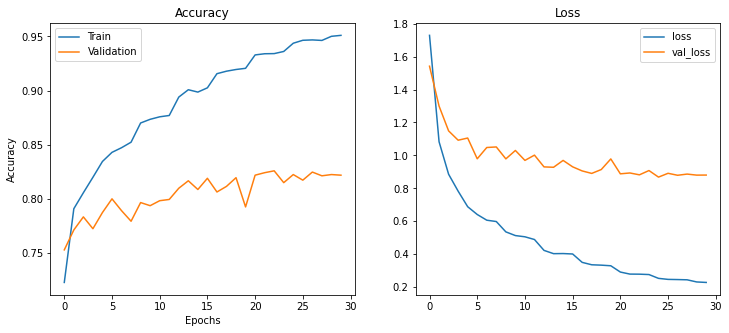

In [ ]:
show_train(history_DNN)

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.67      1.00      0.80         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.33      0.50         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.10      0.20      0.13         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.67      0.86      0.75       147
       IDEOLOGY_OF       0.62      1.00      0.77        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.64      0.50      0.56        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.73      0.51      0.60        53
          OWNER_OF       0.20      0.11

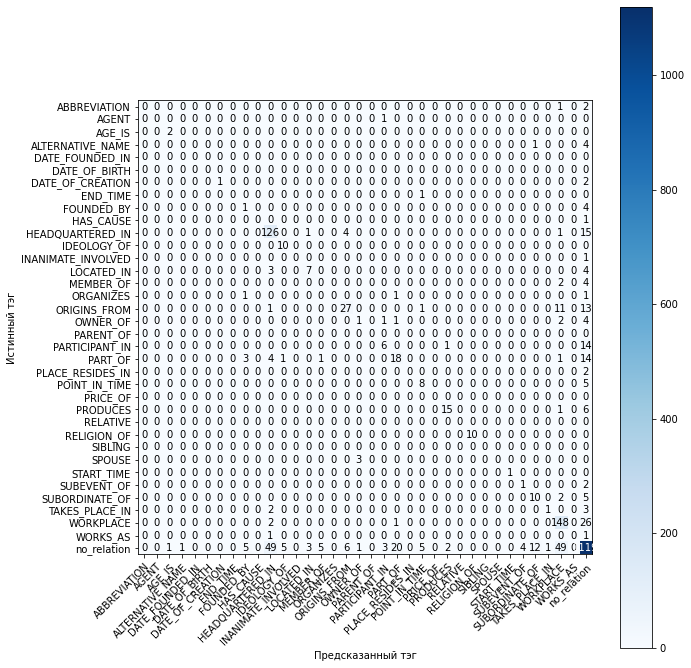

In [ ]:
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict(X_test)
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

## Модель 2: DNN с fasText эмбедингами + onehot типы сущностей (сконкатенированные )

In [ ]:
model_DNN = DNN1(X_train1.shape[1])

model_name = 'DNN2'
model_save_path = os.path.join(model_folder_path, model_name,'best_model.h5')
checkpoint_callback = ModelCheckpoint(model_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

history_DNN = model_DNN.fit(X_train1, y_train,
                              validation_data=(X_dev1, y_dev),
                              epochs=30,
                              batch_size=16,
                              callbacks=[LearningRateScheduler(lr_scheduler, verbose=1),
                                         tensorboard_callback,
                                         checkpoint_callback],
                              class_weight=class_weights,
                              verbose=2)

Epoch 1/30

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 1.7248 - accuracy: 0.7369 - f1_score: 0.0555 - val_loss: 1.5627 - val_accuracy: 0.7570 - val_f1_score: 0.0555

Epoch 00001: val_accuracy improved from -inf to 0.75704, saving model to /content/drive/MyDrive/My_models/task2/DNN2/best_model.h5
Epoch 2/30

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 2s - loss: 1.0470 - accuracy: 0.8050 - f1_score: 0.0555 - val_loss: 1.2137 - val_accuracy: 0.7892 - val_f1_score: 0.0555

Epoch 00002: val_accuracy improved from 0.75704 to 0.78920, saving model to /content/drive/MyDrive/My_models/task2/DNN2/best_model.h5
Epoch 3/30

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 2s - loss: 0.8374 - accuracy: 0.8225 - f1_score: 0.0555 - val_loss: 1.1231 - val_accuracy: 0.7858 - val_f1_score: 0.0555

Epoch 00003: val_accuracy did not improve from 0.78

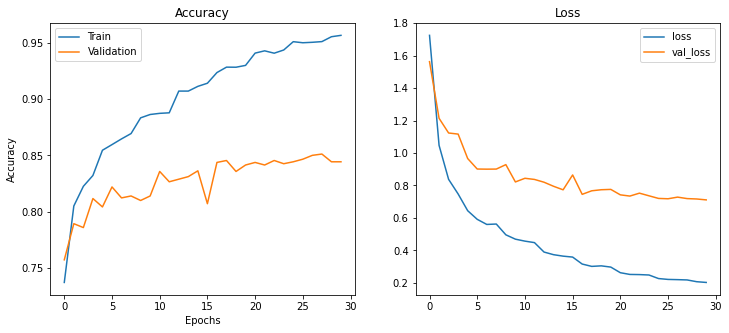

In [ ]:
show_train(history_DNN)

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.00      0.00      0.00         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.33      0.50         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.00      0.00      0.00         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.80      0.90      0.85       147
       IDEOLOGY_OF       0.90      0.90      0.90        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.64      0.64      0.64        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.71      0.47      0.57        53
          OWNER_OF       0.29      0.22

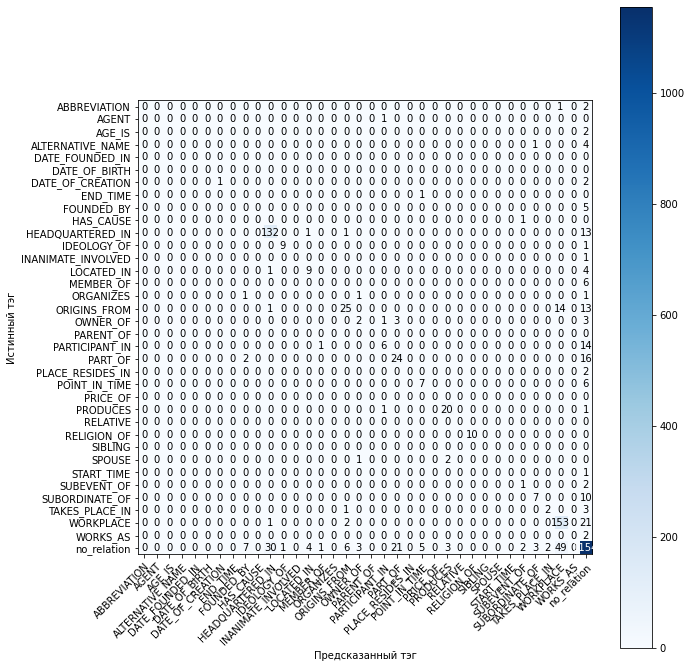

In [ ]:
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict(X_test1)
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

## Модель 3: DNN с fasText эмбедингами + эмбединги типов сущностей

In [ ]:
def lr_scheduler(epoch, lr):
  #start_lr = 0.001
  #if epoch == 1:
  #  return start_lr
  decay_rate = 0.9
  decay_step = 6
  if epoch % decay_step == 0 and epoch:
      return lr * pow(decay_rate, np.floor(epoch / decay_step))
  return lr

def DNN3(feature_size):
  input_embs = Input(shape=feature_size)
  input_subj_type = Input(shape=28)
  input_obj_type = Input(shape=28)

  emb1 =  Embedding(28, 15, trainable=True)(input_subj_type)
  emb2 =  Embedding(28, 15, trainable=True)(input_obj_type)

  flatten1 = keras.layers.Flatten()(emb1)
  flatten2 = keras.layers.Flatten()(emb2)

  conc = keras.layers.Concatenate(axis=1)([input_embs, flatten1, flatten2])

  node = 512
  dense = Dense(node,input_dim=feature_size,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=1e-4, l2=1e-4),
                bias_regularizer=keras.regularizers.l2(1e-4),
                activity_regularizer=keras.regularizers.l2(1e-4))(conc)

  #dropout = Dropout(0.1)(dense)
  output = Dense(num_relations, activation='softmax')(dense)

  model = Model([input_embs, input_subj_type, input_obj_type], output)
  model.compile(loss='sparse_categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy'])
  return model


In [ ]:
model_DNN = DNN3(X_train.shape[1])

model_name = 'DNN3'
model_save_path = os.path.join(model_folder_path, model_name,'best_model.h5')
checkpoint_callback = ModelCheckpoint(model_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

history_DNN = model_DNN.fit([X_train,train_subj_o, train_obj_o], y_train,
                          validation_data=([X_dev, dev_subj_o, dev_obj_o], y_dev),
                          epochs=30,
                          batch_size=16,
                          callbacks = [LearningRateScheduler(lr_scheduler, verbose=1), 
                                       tensorboard_callback,
                                       checkpoint_callback],
                          class_weight=class_weights,
                          verbose=2)

Epoch 1/30

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 4s - loss: 1.6267 - accuracy: 0.7331 - val_loss: 1.4439 - val_accuracy: 0.7748

Epoch 00001: val_accuracy improved from -inf to 0.77484, saving model to /content/drive/MyDrive/My_models/task2/DNN3/best_model.h5
Epoch 2/30

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.9656 - accuracy: 0.8155 - val_loss: 1.1326 - val_accuracy: 0.8047

Epoch 00002: val_accuracy improved from 0.77484 to 0.80471, saving model to /content/drive/MyDrive/My_models/task2/DNN3/best_model.h5
Epoch 3/30

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.7753 - accuracy: 0.8366 - val_loss: 1.0401 - val_accuracy: 0.8110

Epoch 00003: val_accuracy improved from 0.80471 to 0.81103, saving model to /content/drive/MyDrive/My_models/task2/DNN3/best_model.h5
Epoch 4/30

Epoch 00004: LearningRateSchedu

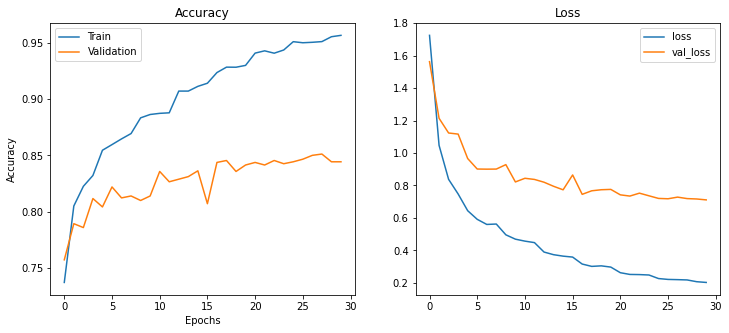

In [ ]:
show_train(history_DNN)

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.50      1.00      0.67         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.33      0.50         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.20      0.40      0.27         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.82      0.90      0.86       147
       IDEOLOGY_OF       0.77      1.00      0.87        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.42      0.71      0.53        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.77      0.57      0.65        53
          OWNER_OF       0.25      0.11

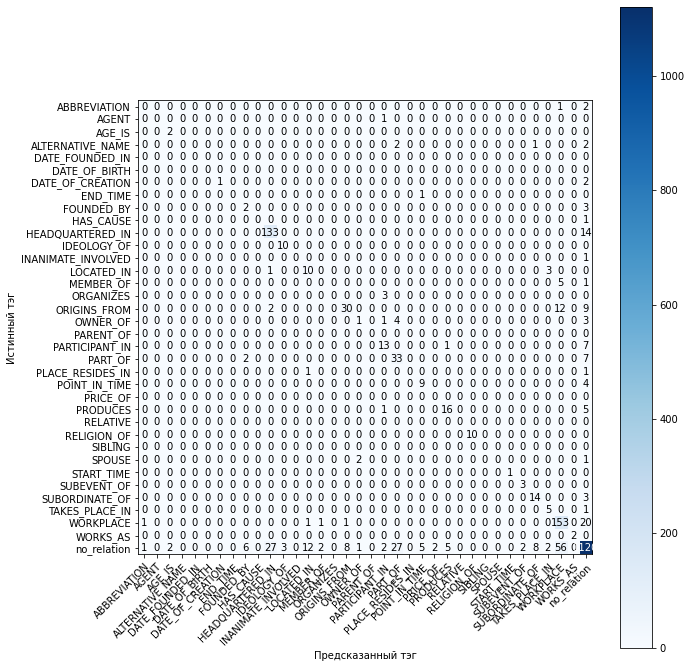

In [ ]:
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict([X_test, test_subj_o, test_obj_o])
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

In [ ]:
# в  среднем - 0.7276
# повышение размерности type emb - 0.7295
#Dropout понизил до 0.7089

#### Понижение размера батчей

In [ ]:
model_DNN = DNN3(X_train.shape[1])

model_name = 'DNN3'
model_save_path = os.path.join(model_folder_path, model_name,'best_model.h5')
checkpoint_callback = ModelCheckpoint(model_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

model_DNN.fit([X_train,train_subj_o, train_obj_o], y_train,
                          validation_data=([X_dev, dev_subj_o, dev_obj_o], y_dev),
                          epochs=30,
                          batch_size=4,
                          callbacks = [LearningRateScheduler(lr_scheduler, verbose=1), 
                                       tensorboard_callback,
                                       checkpoint_callback],
                          #class_weight=class_weights,
                          verbose=2)

Epoch 1/30

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
3682/3682 - 11s - loss: 1.6472 - accuracy: 0.7541 - val_loss: 1.2919 - val_accuracy: 0.7972

Epoch 00001: val_accuracy improved from -inf to 0.79724, saving model to /content/drive/MyDrive/My_models/task2/DNN3/best_model.h5
Epoch 2/30

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
3682/3682 - 10s - loss: 1.1145 - accuracy: 0.8121 - val_loss: 1.2193 - val_accuracy: 0.8041

Epoch 00002: val_accuracy improved from 0.79724 to 0.80414, saving model to /content/drive/MyDrive/My_models/task2/DNN3/best_model.h5
Epoch 3/30

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
3682/3682 - 10s - loss: 1.0132 - accuracy: 0.8317 - val_loss: 1.0942 - val_accuracy: 0.8122

Epoch 00003: val_accuracy improved from 0.80414 to 0.81218, saving model to /content/drive/MyDrive/My_models/task2/DNN3/best_model.h5
Epoch 4/30

Epoch 00004: LearningR

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.50      0.50      0.50         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.33      0.50         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.33      0.20      0.25         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.88      0.83      0.85       147
       IDEOLOGY_OF       0.83      0.50      0.62        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.71      0.86      0.77        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.72      0.74      0.73        53
          OWNER_OF       0.50      0.22

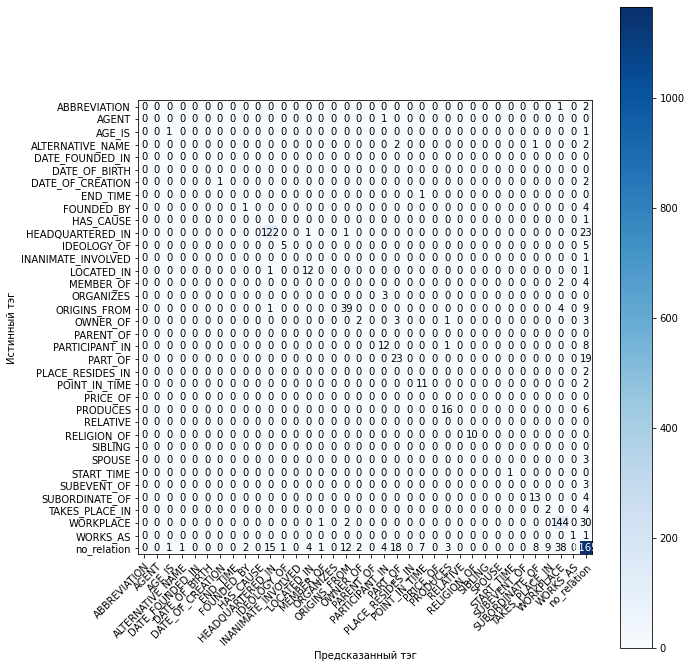

In [ ]:
# в жопу понижение батчей
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict([X_test, test_subj_o, test_obj_o])
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

## Модель 4: модель 3 + уменьшение негативных примеров "no_relation" в train

## Модель 5: модель 3 + по-другому взятые эмбединги + флаг пересечения сущностей

In [ ]:
model_DNN = DNN3(X_train4.shape[1])

model_name = 'DNN4'
model_save_path = os.path.join(model_folder_path, model_name,'best_model.h5')
checkpoint_callback = ModelCheckpoint(model_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

history_DNN = model_DNN.fit([X_train4,train_subj_o, train_obj_o], y_train,
                          validation_data=([X_dev4, dev_subj_o, dev_obj_o], y_dev),
                          epochs=30,
                          batch_size=16,
                          callbacks = [LearningRateScheduler(lr_scheduler, verbose=1), 
                                       tensorboard_callback,
                                       checkpoint_callback],
                          class_weight=class_weights,
                          verbose=2)

Epoch 1/30

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 4s - loss: 1.6284 - accuracy: 0.7420 - val_loss: 1.5272 - val_accuracy: 0.7415

Epoch 00001: val_accuracy improved from -inf to 0.74153, saving model to /content/drive/MyDrive/My_models/task2/DNN4/best_model.h5
Epoch 2/30

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.9701 - accuracy: 0.8172 - val_loss: 1.0852 - val_accuracy: 0.8185

Epoch 00002: val_accuracy improved from 0.74153 to 0.81850, saving model to /content/drive/MyDrive/My_models/task2/DNN4/best_model.h5
Epoch 3/30

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.7711 - accuracy: 0.8427 - val_loss: 0.9991 - val_accuracy: 0.8173

Epoch 00003: val_accuracy did not improve from 0.81850
Epoch 4/30

Epoch 00004: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.668

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.50      0.50      0.50         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       0.00      0.00      0.00         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.14      0.20      0.17         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.84      0.92      0.88       147
       IDEOLOGY_OF       0.77      1.00      0.87        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.60      0.86      0.71        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.78      0.53      0.63        53
          OWNER_OF       0.67      0.22

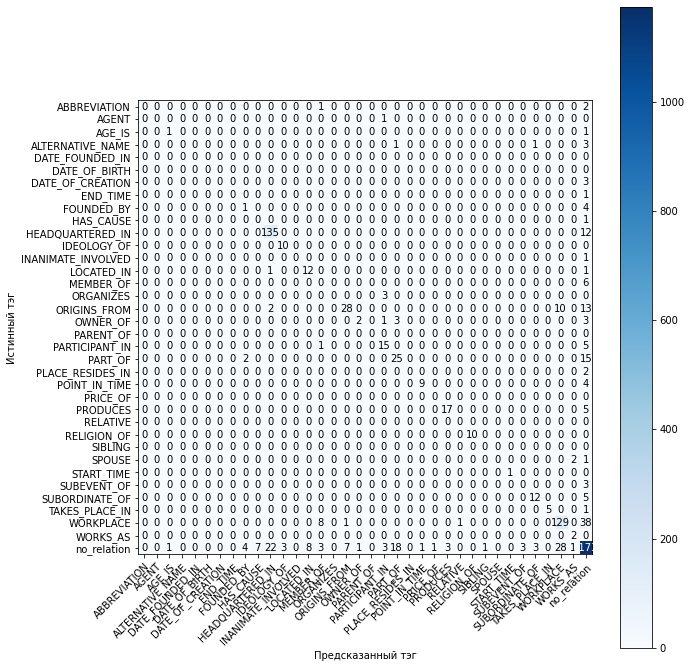

In [ ]:
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict([X_test4, test_subj_o, test_obj_o])
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

In [ ]:
# применение флага пересечения сущностей не улучшило
# 0.71 gjckt после применеия в DNN3

#### Возьмем эмбединги по-другому

In [ ]:
model_DNN = DNN3(X_train2.shape[1])

model_name = 'DNN5'
model_save_path = os.path.join(model_folder_path, model_name,'best_model.h5')
checkpoint_callback = ModelCheckpoint(model_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

history_DNN = model_DNN.fit([X_train2,train_subj_o, train_obj_o], y_train,
                          validation_data=([X_dev2, dev_subj_o, dev_obj_o], y_dev),
                          epochs=30,
                          batch_size=16,
                          callbacks = [LearningRateScheduler(lr_scheduler, verbose=1), 
                                       tensorboard_callback,
                                       checkpoint_callback],
                          class_weight=class_weights,
                          verbose=2)

Epoch 1/30

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 4s - loss: 1.5982 - accuracy: 0.7188 - val_loss: 1.3188 - val_accuracy: 0.7565

Epoch 00001: val_accuracy improved from -inf to 0.75646, saving model to /content/drive/MyDrive/My_models/task2/DNN5/best_model.h5
Epoch 2/30

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.9638 - accuracy: 0.7776 - val_loss: 1.0319 - val_accuracy: 0.7858

Epoch 00002: val_accuracy improved from 0.75646 to 0.78576, saving model to /content/drive/MyDrive/My_models/task2/DNN5/best_model.h5
Epoch 3/30

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.7690 - accuracy: 0.8004 - val_loss: 0.9302 - val_accuracy: 0.7904

Epoch 00003: val_accuracy improved from 0.78576 to 0.79035, saving model to /content/drive/MyDrive/My_models/task2/DNN5/best_model.h5
Epoch 4/30

Epoch 00004: LearningRateSchedu

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.67      1.00      0.80         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      1.00      1.00         3
          END_TIME       1.00      1.00      1.00         1
        FOUNDED_BY       1.00      0.20      0.33         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.75      0.94      0.84       147
       IDEOLOGY_OF       0.77      1.00      0.87        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.67      0.86      0.75        14
         MEMBER_OF       0.38      0.83      0.53         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.71      0.32      0.44        53
          OWNER_OF       0.50      0.33

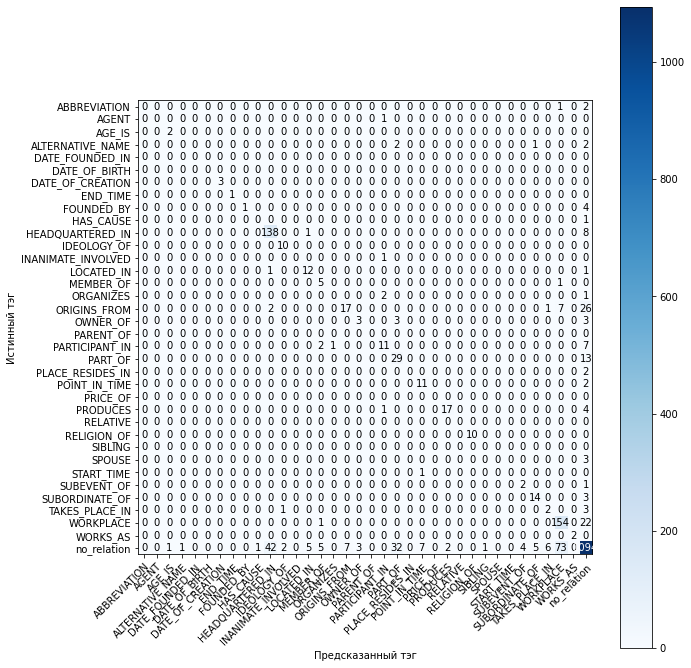

In [ ]:
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict([X_test2, test_subj_o, test_obj_o])
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

##### Еще по-другому

In [ ]:
model_DNN = DNN3(X_train3.shape[1])

model_name = 'DNN7'
model_save_path = os.path.join(model_folder_path, model_name,'best_model.h5')
checkpoint_callback = ModelCheckpoint(model_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

history_DNN = model_DNN.fit([X_train3,train_subj_o, train_obj_o], y_train,
                          validation_data=([X_dev3, dev_subj_o, dev_obj_o], y_dev),
                          epochs=40,
                          batch_size=16,
                          callbacks = [LearningRateScheduler(lr_scheduler, verbose=1), 
                                       tensorboard_callback,
                                       checkpoint_callback],
                          class_weight=class_weights,
                          verbose=2)

Epoch 1/40

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 4s - loss: 1.6119 - accuracy: 0.7245 - val_loss: 1.3493 - val_accuracy: 0.7714

Epoch 00001: val_accuracy improved from -inf to 0.77140, saving model to /content/drive/MyDrive/My_models/task2/DNN7/best_model.h5
Epoch 2/40

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.9517 - accuracy: 0.7970 - val_loss: 1.1082 - val_accuracy: 0.7846

Epoch 00002: val_accuracy improved from 0.77140 to 0.78461, saving model to /content/drive/MyDrive/My_models/task2/DNN7/best_model.h5
Epoch 3/40

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.7612 - accuracy: 0.8176 - val_loss: 0.8916 - val_accuracy: 0.8128

Epoch 00003: val_accuracy improved from 0.78461 to 0.81275, saving model to /content/drive/MyDrive/My_models/task2/DNN7/best_model.h5
Epoch 4/40

Epoch 00004: LearningRateSchedu

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.00      0.00      0.00         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.33      0.50         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.29      0.40      0.33         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.81      0.95      0.88       147
       IDEOLOGY_OF       0.83      1.00      0.91        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.64      0.64      0.64        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.75      0.51      0.61        53
          OWNER_OF       0.60      0.33

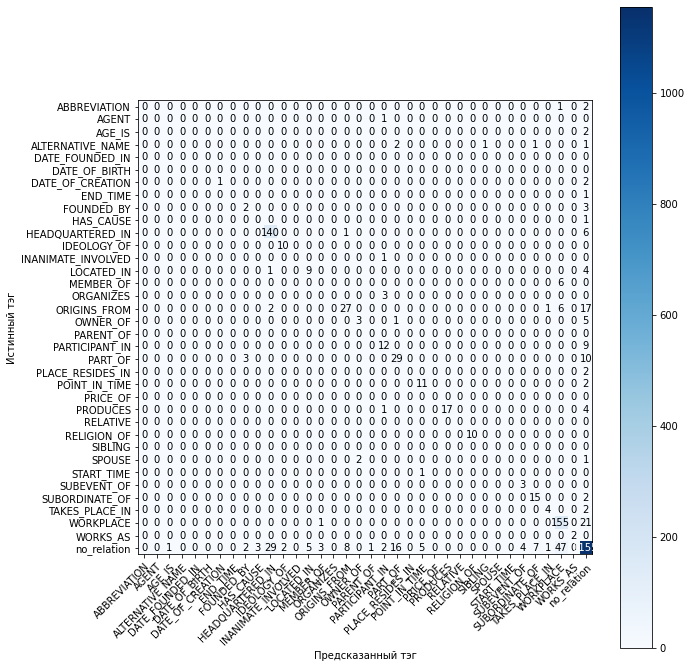

In [ ]:
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict([X_test3, test_subj_o, test_obj_o])
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

In [ ]:
model_best = model_DNN

In [ ]:
model_DNN7 = DNN8(X_train3.shape[1])

model_name = 'DNN88'
model_save_path = os.path.join(model_folder_path, model_name,'best_model.h5')
checkpoint_callback = ModelCheckpoint(model_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

history_DNN = model_DNN7.fit([X_train3,train_subj0, train_obj0], y_train,
                          validation_data=([X_dev3, dev_subj0, dev_obj0], y_dev),
                          epochs=60,
                          batch_size=16,
                          callbacks = [LearningRateScheduler(lr_scheduler, verbose=1), 
                                       tensorboard_callback,
                                       checkpoint_callback],
                          class_weight=class_weights,
                          verbose=2)

TypeError: ignored

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.50      0.50      0.50         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      1.00      1.00         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.20      0.40      0.27         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.83      0.94      0.88       147
       IDEOLOGY_OF       0.82      0.90      0.86        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.63      0.86      0.73        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.74      0.53      0.62        53
          OWNER_OF       0.57      0.44

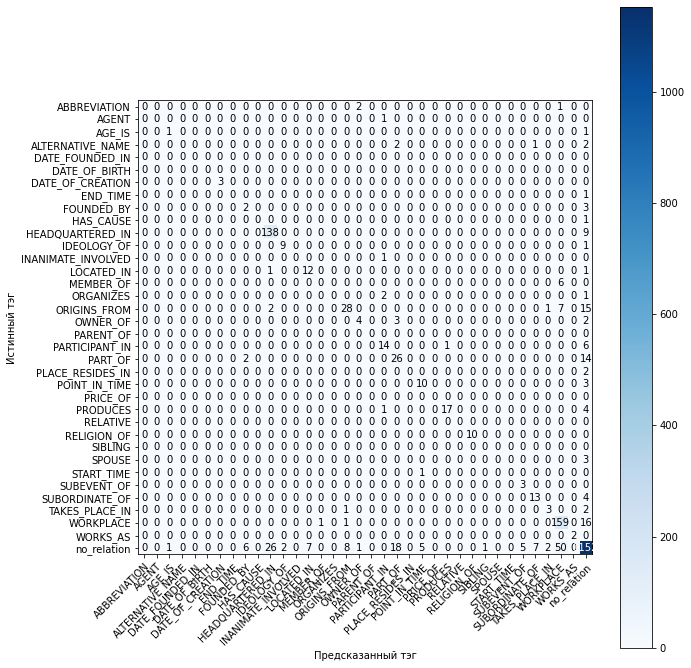

In [ ]:
model_DNN7.load_weights(model_save_path)
prob_predict = model_DNN7.predict([X_test3, test_subj0, test_obj0])
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

## Модель 6: модель + add layers вместо concat 

In [ ]:
def lr_scheduler(epoch, lr):
  #start_lr = 0.001
  #if epoch == 1:
  #  return start_lr
  decay_rate = 0.9
  decay_step = 5
  if epoch % decay_step == 0 and epoch:
      return lr * pow(decay_rate, np.floor(epoch / decay_step))
  return lr

def DNN6(feature_size):
  input_subj = Input(shape=feature_size)
  input_obj = Input(shape=feature_size)
  input_flag = Input(shape=feature_size)
  input_subj_type = Input(shape=28)
  input_obj_type = Input(shape=28)

  emb1 =  Embedding(28, 15, trainable=True)(input_subj_type)
  emb2 =  Embedding(28, 15, trainable=True)(input_obj_type)

  flatten1 = keras.layers.Flatten()(emb1)
  flatten2 = keras.layers.Flatten()(emb2)

  dense_subj = Dense(300, activation='softmax')(flatten1)
  dense_obj = Dense(300, activation='softmax')(flatten1)

  dot1 = keras.layers.Dot(axes=(1))([input_subj, dense_subj])
  dot2 = keras.layers.Dot(axes=(1))([input_obj, dense_obj])

  conc = keras.layers.Concatenate(axis=1)([input_subj, input_obj, dot1, dot2, flatten1, flatten2])

  node = 512
  dense = Dense(node,input_dim=feature_size,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=1e-4, l2=1e-4),
                bias_regularizer=keras.regularizers.l2(1e-4),
                activity_regularizer=keras.regularizers.l2(1e-4))(conc)

  #dropout = Dropout(0.1)(dense)
  output = Dense(num_relations, activation='softmax')(dense)

  model = Model([input_subj, input_obj, input_subj_type, input_obj_type], output)
  model.compile(loss='sparse_categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy'])
  return model

In [ ]:
def lr_scheduler(epoch, lr):
  #start_lr = 0.001
  #if epoch == 1:
  #  return start_lr
  decay_rate = 0.9
  decay_step = 8
  if epoch % decay_step == 0 and epoch:
      return lr * pow(decay_rate, np.floor(epoch / decay_step))
  return lr

def DNN_dot(feature_size):
  input_embs = Input(shape=feature_size)
  input_subj_type = Input(shape=1)
  input_obj_type = Input(shape=1)

  emb1 =  Embedding(28, 300, trainable=True)(input_subj_type)
  emb2 =  Embedding(28, 300, trainable=True)(input_obj_type)

  flatten1 = keras.layers.Flatten()(emb1)
  flatten2 = keras.layers.Flatten()(emb2)

  #dot1 = keras.layers.Dot(axes=(1))([input_subj, emb1])
  #dot2 = keras.layers.Dot(axes=(1))([input_obj, emb2])

  add1 = keras.layers.Dot(axes=(1))([input_subj, emb1])
  add2 = keras.layers.Dot(axes=(1))([input_obj, emb2])

  conc = keras.layers.Concatenate(axis=1)([dot1, dot2, flatten1, flatten2])

  node = 512
  dense = Dense(node,input_dim=feature_size,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=1e-4, l2=1e-4),
                bias_regularizer=keras.regularizers.l2(1e-4),
                activity_regularizer=keras.regularizers.l2(1e-4))(conc)

  dropout = Dropout(0.2)(dense)
  output = Dense(num_relations, activation='softmax')(dense)

  model = Model([input_embs, input_subj_type, input_obj_type], output)
  model.compile(loss='sparse_categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy'])
  return model


In [ ]:
model_DNN7 = DNN1(X_train3.shape[1])

model_name = 'DNN11'
model_save_path = os.path.join(model_folder_path, model_name,'best_model.h5')
checkpoint_callback = ModelCheckpoint(model_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

history_DNN = model_DNN7.fit([X_train3,train_subj0, train_obj0], y_train,
                          validation_data=([X_dev3, dev_subj0, dev_obj0], y_dev),
                          epochs=60,
                          batch_size=16,
                          callbacks = [LearningRateScheduler(lr_scheduler, verbose=1), 
                                       tensorboard_callback,
                                       checkpoint_callback],
                          class_weight=class_weights,
                          verbose=2)

Epoch 1/60

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.


ValueError: ignored

In [ ]:
cross_train = np.array(cross_train)
cross_dev = np.array(cross_dev)
cross_test = np.array(cross_test)

In [ ]:
X_train31 = np.array([x for x,y in train_vecs])
X_train32 = np.array([y for x,y in train_vecs])

In [ ]:
X_dev31 = np.array([x for x,y in dev_vecs])
X_dev32 = np.array([y for x,y in dev_vecs])

X_test31 = np.array([x for x,y in test_vecs])
X_test32 = np.array([y for x,y in test_vecs])

In [ ]:
model_DNN = DNN11(X_train31.shape[1])

model_name = 'DNN6'
model_save_path = os.path.join(model_folder_path, model_name,'best_model.h5')
checkpoint_callback = ModelCheckpoint(model_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

history_DNN = model_DNN.fit([X_train31, X_train32,train_subj_o, train_obj_o], y_train,
                          validation_data=([X_dev31, X_dev32, dev_subj_o, dev_obj_o], y_dev),
                          epochs=40,
                          batch_size=32,
                          callbacks = [LearningRateScheduler(lr_scheduler, verbose=1), 
                                       tensorboard_callback,
                                       checkpoint_callback],
                          class_weight=class_weights,
                          verbose=2)

Epoch 1/40

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
461/461 - 3s - loss: 1.7943 - accuracy: 0.7324 - val_loss: 1.6526 - val_accuracy: 0.7840

Epoch 00001: val_accuracy improved from -inf to 0.78403, saving model to /content/drive/MyDrive/My_models/task2/DNN6/best_model.h5
Epoch 2/40

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
461/461 - 1s - loss: 1.1435 - accuracy: 0.8190 - val_loss: 1.3218 - val_accuracy: 0.7990

Epoch 00002: val_accuracy improved from 0.78403 to 0.79897, saving model to /content/drive/MyDrive/My_models/task2/DNN6/best_model.h5
Epoch 3/40

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
461/461 - 1s - loss: 0.8910 - accuracy: 0.8345 - val_loss: 1.1259 - val_accuracy: 0.7978

Epoch 00003: val_accuracy did not improve from 0.79897
Epoch 4/40

Epoch 00004: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
461/461 - 1s - loss: 0.754

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       1.00      0.50      0.67         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.33      0.50         3
          END_TIME       1.00      1.00      1.00         1
        FOUNDED_BY       0.11      0.20      0.14         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.82      0.89      0.86       147
       IDEOLOGY_OF       0.83      1.00      0.91        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.62      0.57      0.59        14
         MEMBER_OF       0.67      0.33      0.44         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.71      0.45      0.55        53
          OWNER_OF       0.25      0.22

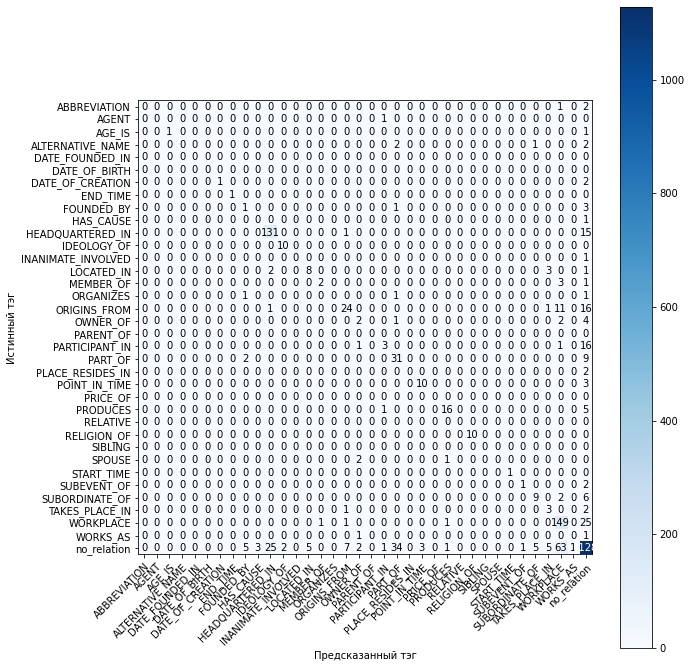

In [ ]:
model_DNN.load_weights(model_save_path)
prob_predict = model_DNN.predict([X_test31, X_test32, test_subj_o, test_obj_o])
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

In [ ]:
'''
Со сложением вместо concatenate 
Without no_relation class:
f1_micro: 0.6778, f1_macro: 0.3047
'''

# Анализ модели

In [ ]:
model_best

In [ ]:
test_prob = model_best.predict([X_test3, test_subj_o, test_obj_o])
test_predict = np.argmax(test_prob, axis =1)

dev_prob = model_best.predict([X_dev3, dev_subj_o, dev_obj_o])
dev_predict = np.argmax(dev_prob, axis =1)

train_prob = model_best.predict([X_train3, train_subj_o, train_obj_o])
train_predict = np.argmax(train_prob, axis =1)

#stat(y_test, test_predict)

In [ ]:
all_predicts = np.concatenate((train_predict, dev_predict, test_predict))
all_probs = np.max(np.concatenate((train_prob, dev_prob, test_prob)), axis = 1)
all_y = np.concatenate((y_train, y_dev, y_test))

In [ ]:
all_data = train_data + dev_data + test_data

In [ ]:
true_labels = [labelEnc.inverse_transform([y])[0] for y in all_y]
predict_labels = [labelEnc.inverse_transform([y])[0] for y in all_predicts]

In [ ]:
mistakes = [{'true': true, 'predict': pred, 'confidence_of_prediction': round(float(all_probs[i]), 3) , 'pair':all_data[i]} 
       for i, (true, pred) in enumerate(zip(true_labels, predict_labels)) if true != pred]

In [ ]:
choice(mistakes)

{'confidence_of_prediction': 0.95,
 'pair': {'cover': 'правоцентристское правительство Словении',
  'cover_type': 'ORGANIZATION',
  'file': '26416_text',
  'obj': 'Словении',
  'obj_type': 'COUNTRY',
  'rel': 'no_relation',
  'subj': 'правительство Словении',
  'subj_type': 'ORGANIZATION'},
 'predict': 'HEADQUARTERED_IN',
 'true': 'no_relation'}

In [ ]:
choice(mistakes)

{'confidence_of_prediction': 0.88,
 'pair': {'cover': 'администрации президента США',
  'cover_type': 'ORGANIZATION',
  'file': '27_11_12d',
  'obj': 'США',
  'obj_type': 'COUNTRY',
  'rel': 'no_relation',
  'subj': 'администрации президента США',
  'subj_type': 'ORGANIZATION'},
 'predict': 'HEADQUARTERED_IN',
 'true': 'no_relation'}

In [ ]:
choice(mistakes)

{'confidence_of_prediction': 0.95,
 'pair': {'cover': 'части 1 статьи 318 УК РФ «угроза применения насилия в '
                   'отношении представителя власти',
          'cover_type': 'LAW',
          'file': '511580_text',
          'obj': 'РФ',
          'obj_type': 'COUNTRY',
          'rel': 'ORIGINS_FROM',
          'subj': 'УК',
          'subj_type': 'LAW'},
 'predict': 'no_relation',
 'true': 'ORIGINS_FROM'}


In [ ]:
pprint(choice(mistakes))

{'confidence_of_prediction': 0.66,
 'pair': {'cover': 'Представитель министерства иностранных дел Германии',
          'cover_type': 'PROFESSION',
          'file': '1592_text',
          'obj': 'министерства иностранных дел',
          'obj_type': 'ORGANIZATION',
          'rel': 'no_relation',
          'subj': 'Представитель министерства иностранных дел Германии',
          'subj_type': 'PROFESSION'},
 'predict': 'WORKPLACE',
 'true': 'no_relation'}


In [ ]:
pprint(choice(mistakes))

{'confidence_of_prediction': 0.92,
 'pair': {'cover': 'Национальной системы здравоохранения Великобритании',
          'cover_type': 'ORGANIZATION',
          'file': '597958_text',
          'obj': 'Великобритании',
          'obj_type': 'COUNTRY',
          'rel': 'no_relation',
          'subj': 'Национальной системы здравоохранения Великобритании',
          'subj_type': 'ORGANIZATION'},
 'predict': 'HEADQUARTERED_IN',
 'true': 'no_relation'}


In [ ]:
argsort_ind = np.argsort(np.array([ex['confidence_of_prediction'] for ex in mistakes]))

In [ ]:
for i in argsort_ind[:10]:
  pprint(mistakes[i])

{'confidence_of_prediction': 0.286,
 'pair': {'cover': 'Государственная корпорация по космической деятельности '
                   '«Роскосмос',
          'cover_type': 'ORGANIZATION',
          'file': '194112_text',
          'obj': 'Роскосмос',
          'obj_type': 'ORGANIZATION',
          'rel': 'ALTERNATIVE_NAME',
          'subj': 'Государственная корпорация по космической деятельности '
                  '«Роскосмос',
          'subj_type': 'ORGANIZATION'},
 'predict': 'PART_OF',
 'true': 'ALTERNATIVE_NAME'}
{'confidence_of_prediction': 0.354,
 'pair': {'cover': 'Зампредседателя Общественного совета при ГУ МВД России по '
                   'Москве',
          'cover_type': 'PROFESSION',
          'file': '20090_text',
          'obj': 'ГУ МВД России по Москве',
          'obj_type': 'ORGANIZATION',
          'rel': 'FOUNDED_BY',
          'subj': 'Общественного совета при ГУ МВД России по Москве',
          'subj_type': 'ORGANIZATION'},
 'predict': 'PART_OF',
 'true': 'FOUND

In [ ]:
for i in argsort_ind[-10:]:
  pprint(mistakes[i])

{'confidence_of_prediction': 0.999,
 'pair': {'cover': 'Public Health England',
          'cover_type': 'ORGANIZATION',
          'file': '598551_text',
          'obj': 'England',
          'obj_type': 'COUNTRY',
          'rel': 'no_relation',
          'subj': 'Public Health England',
          'subj_type': 'ORGANIZATION'},
 'predict': 'HEADQUARTERED_IN',
 'true': 'no_relation'}
{'confidence_of_prediction': 1.0,
 'pair': {'cover': 'Один день Ивана Денисовича',
          'cover_type': 'WORK_OF_ART',
          'file': '228015_text',
          'obj': 'Ивана Денисовича',
          'obj_type': 'PERSON',
          'rel': 'ORIGINS_FROM',
          'subj': 'Один день Ивана Денисовича',
          'subj_type': 'WORK_OF_ART'},
 'predict': 'no_relation',
 'true': 'ORIGINS_FROM'}
{'confidence_of_prediction': 1.0,
 'pair': {'cover': 'Один день Ивана Денисовича',
          'cover_type': 'WORK_OF_ART',
          'file': '228015_text',
          'obj': 'Ивана Денисовича',
          'obj_type': 'PERS

In [ ]:
mistakes_no_relation = [ex for ex in mistakes if ex['true'] == 'no_relation' or ex['predict'] == 'no_relation']

In [ ]:
choice(mistakes_no_relation)

{'confidence_of_prediction': 0.483,
 'pair': {'cover': 'Следственного комитета при прокуратуре РФ',
  'cover_type': 'ORGANIZATION',
  'file': '176',
  'obj': 'прокуратуре РФ',
  'obj_type': 'ORGANIZATION',
  'rel': 'FOUNDED_BY',
  'subj': 'Следственного комитета при прокуратуре РФ',
  'subj_type': 'ORGANIZATION'},
 'predict': 'no_relation',
 'true': 'FOUNDED_BY'}

In [ ]:
folder = '/content/drive/MyDrive/My_models/task2/results'

In [ ]:
with open(os.path.join(folder, 'no_relation_mistakes.json'), 'w') as f:
  json.dump(mistakes_no_relation, f)
with open(os.path.join(folder, 'model_mistakes.json'), 'w') as f:
  json.dump(mistakes, f)

In [ ]:
with open(os.path.join(folder, 'no_relation_mistakes.json'), 'r') as f:
  a= json.load(f)

In [ ]:
choice(a)

{'confidence_of_prediction': 0.768,
 'pair': {'cover': 'Федеральный суд Южного округа Нью-Йорка',
  'cover_type': 'ORGANIZATION',
  'file': '23466_text',
  'obj': 'Нью-Йорка',
  'obj_type': 'CITY',
  'rel': 'no_relation',
  'subj': 'Федеральный суд Южного округа Нью-Йорка',
  'subj_type': 'ORGANIZATION'},
 'predict': 'HEADQUARTERED_IN',
 'true': 'no_relation'}

# Итоговая модель


In [ ]:
def lr_scheduler(epoch, lr):
  #start_lr = 0.001
  #if epoch == 1:
  #  return start_lr
  decay_rate = 0.9
  decay_step = 8
  if epoch % decay_step == 0 and epoch:
      return lr * pow(decay_rate, np.floor(epoch / decay_step))
  return lr

def DNN8(feature_size):
  input_embs = Input(shape=feature_size)
  input_subj_type = Input(shape=1)
  input_obj_type = Input(shape=1)

  emb1 =  Embedding(28, 15, trainable=True)(input_subj_type)
  emb2 =  Embedding(28, 15, trainable=True)(input_obj_type)

  flatten1 = keras.layers.Flatten()(emb1)
  flatten2 = keras.layers.Flatten()(emb2)

  conc = keras.layers.Concatenate(axis=1)([input_embs, flatten1, flatten2])

  node = 512
  dense = Dense(node,input_dim=feature_size,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=1e-4, l2=1e-4),
                bias_regularizer=keras.regularizers.l2(1e-4),
                activity_regularizer=keras.regularizers.l2(1e-4))(conc)

  dropout = Dropout(0.3)(dense)
  output = Dense(num_relations, activation='softmax')(dense)

  model = Model([input_embs, input_subj_type, input_obj_type], output)
  model.compile(loss='sparse_categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy'])
  return model


In [ ]:
model_DNN7 = DNN8(X_train3.shape[1])

model_name = 'DNN88'
model_save_path = os.path.join(model_folder_path, model_name,'best_model.h5')
checkpoint_callback = ModelCheckpoint(model_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

history_DNN = model_DNN7.fit([X_train3,train_subj0, train_obj0], y_train,
                          validation_data=([X_dev3, dev_subj0, dev_obj0], y_dev),
                          epochs=60,
                          batch_size=16,
                          callbacks = [LearningRateScheduler(lr_scheduler, verbose=1), 
                                       tensorboard_callback,
                                       checkpoint_callback],
                          class_weight=class_weights,
                          verbose=2)

Epoch 1/60

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 4s - loss: 1.6570 - accuracy: 0.7270 - val_loss: 1.3430 - val_accuracy: 0.7817

Epoch 00001: val_accuracy improved from -inf to 0.78173, saving model to /content/drive/MyDrive/My_models/task2/DNN88/best_model.h5
Epoch 2/60

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.9680 - accuracy: 0.7872 - val_loss: 1.1287 - val_accuracy: 0.7720

Epoch 00002: val_accuracy did not improve from 0.78173
Epoch 3/60

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.7771 - accuracy: 0.8110 - val_loss: 0.9138 - val_accuracy: 0.8139

Epoch 00003: val_accuracy improved from 0.78173 to 0.81390, saving model to /content/drive/MyDrive/My_models/task2/DNN88/best_model.h5
Epoch 4/60

Epoch 00004: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.6

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.00      0.00      0.00         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.67      0.80         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.14      0.20      0.17         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.82      0.96      0.88       147
       IDEOLOGY_OF       0.83      1.00      0.91        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.75      0.64      0.69        14
         MEMBER_OF       0.29      0.33      0.31         6
         ORGANIZES       1.00      0.33      0.50         3
      ORIGINS_FROM       0.76      0.53      0.62        53
          OWNER_OF       0.60      0.33

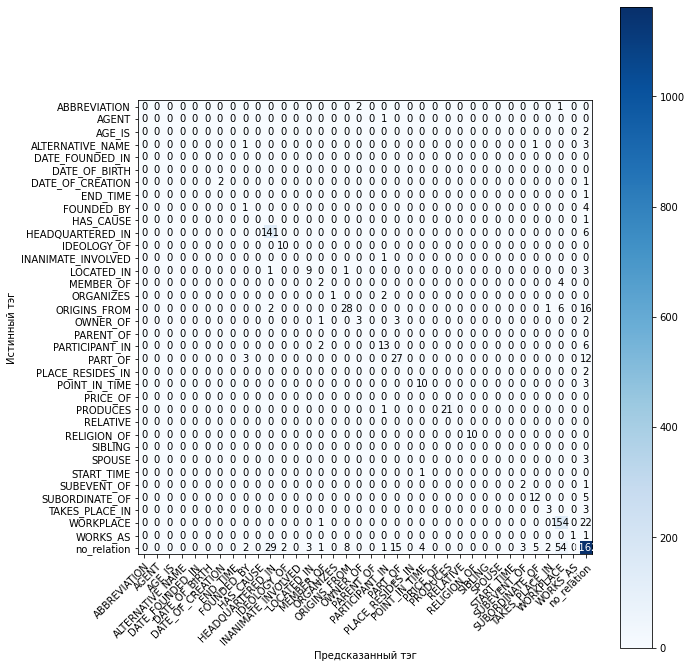

In [ ]:
model_DNN7.load_weights(model_save_path)
prob_predict = model_DNN7.predict([X_test3, test_subj0, test_obj0])
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

In [ ]:
model_DNN7 = DNN8(X_train3.shape[1])

model_name = 'DNN88'
model_save_path = os.path.join(model_folder_path, model_name,'best_model.h5')
checkpoint_callback = ModelCheckpoint(model_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

history_DNN = model_DNN7.fit([X_train3,train_subj0, train_obj0], y_train,
                          validation_data=([X_dev3, dev_subj0, dev_obj0], y_dev),
                          epochs=60,
                          batch_size=16,
                          callbacks = [LearningRateScheduler(lr_scheduler, verbose=1), 
                                       tensorboard_callback,
                                       checkpoint_callback],
                          class_weight=class_weights,
                          verbose=2)

Epoch 1/60

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 4s - loss: 1.5411 - accuracy: 0.6887 - val_loss: 1.5412 - val_accuracy: 0.7249

Epoch 00001: val_accuracy improved from -inf to 0.72487, saving model to /content/drive/MyDrive/My_models/task2/DNN88/best_model.h5
Epoch 2/60

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.8743 - accuracy: 0.7697 - val_loss: 1.1320 - val_accuracy: 0.7547

Epoch 00002: val_accuracy improved from 0.72487 to 0.75474, saving model to /content/drive/MyDrive/My_models/task2/DNN88/best_model.h5
Epoch 3/60

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.7030 - accuracy: 0.7858 - val_loss: 0.9646 - val_accuracy: 0.7852

Epoch 00003: val_accuracy improved from 0.75474 to 0.78518, saving model to /content/drive/MyDrive/My_models/task2/DNN88/best_model.h5
Epoch 4/60

Epoch 00004: LearningRateSch

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.67      1.00      0.80         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.67      0.80         3
          END_TIME       1.00      1.00      1.00         1
        FOUNDED_BY       0.00      0.00      0.00         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.81      0.97      0.88       147
       IDEOLOGY_OF       0.83      1.00      0.91        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.65      0.79      0.71        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       1.00      0.33      0.50         3
      ORIGINS_FROM       0.65      0.62      0.63        53
          OWNER_OF       1.00      0.33

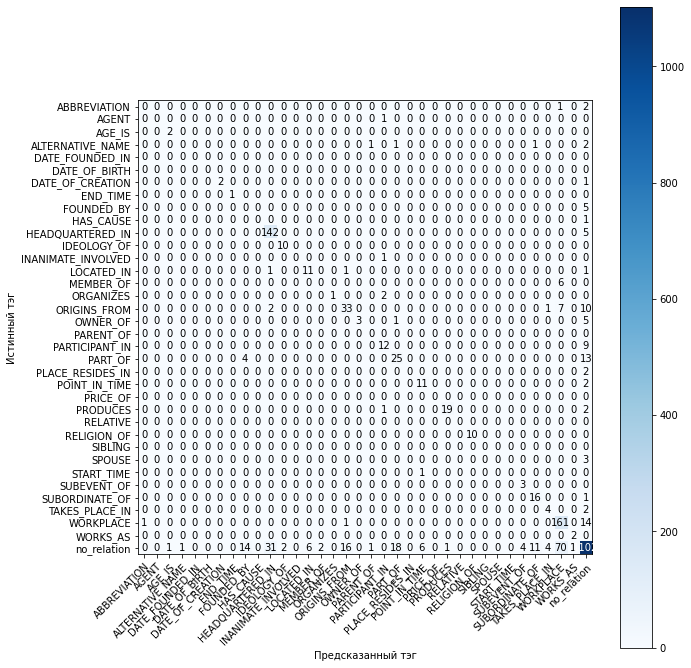

In [ ]:
model_DNN7.load_weights(model_save_path)
prob_predict = model_DNN7.predict([X_test3, test_subj0, test_obj0])
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

In [ ]:
#______________________
model_DNN7 = DNN8(X_train3.shape[1])

model_name = 'DNN88'
model_save_path = os.path.join(model_folder_path, model_name,'best_model_17_05_0.h5')
checkpoint_callback = ModelCheckpoint(model_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

history_DNN = model_DNN7.fit([X_train3,train_subj0, train_obj0], y_train,
                          validation_data=([X_dev3, dev_subj0, dev_obj0], y_dev),
                          epochs=60,
                          batch_size=16,
                          callbacks = [LearningRateScheduler(lr_scheduler, verbose=1), 
                                       tensorboard_callback,
                                       checkpoint_callback],
                          class_weight=class_weights,
                          verbose=2)

Epoch 1/60

Epoch 00001: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 4s - loss: 1.6604 - accuracy: 0.7226 - val_loss: 1.4023 - val_accuracy: 0.7702

Epoch 00001: val_accuracy improved from -inf to 0.77025, saving model to /content/drive/MyDrive/My_models/task2/DNN88/best_model_17_05_0.h5
Epoch 2/60

Epoch 00002: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.9793 - accuracy: 0.7859 - val_loss: 1.1063 - val_accuracy: 0.7737

Epoch 00002: val_accuracy improved from 0.77025 to 0.77369, saving model to /content/drive/MyDrive/My_models/task2/DNN88/best_model_17_05_0.h5
Epoch 3/60

Epoch 00003: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
921/921 - 3s - loss: 0.8075 - accuracy: 0.8057 - val_loss: 0.9579 - val_accuracy: 0.8082

Epoch 00003: val_accuracy improved from 0.77369 to 0.80816, saving model to /content/drive/MyDrive/My_models/task2/DNN88/best_model_17_05_0.h5
Epoch 4/60

Epoc

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.50      1.00      0.67         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.67      0.80         3
          END_TIME       0.00      0.00      0.00         1
        FOUNDED_BY       0.25      0.40      0.31         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.80      0.93      0.86       147
       IDEOLOGY_OF       0.83      1.00      0.91        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.64      0.64      0.64        14
         MEMBER_OF       0.75      0.50      0.60         6
         ORGANIZES       0.00      0.00      0.00         3
      ORIGINS_FROM       0.78      0.47      0.59        53
          OWNER_OF       0.67      0.22

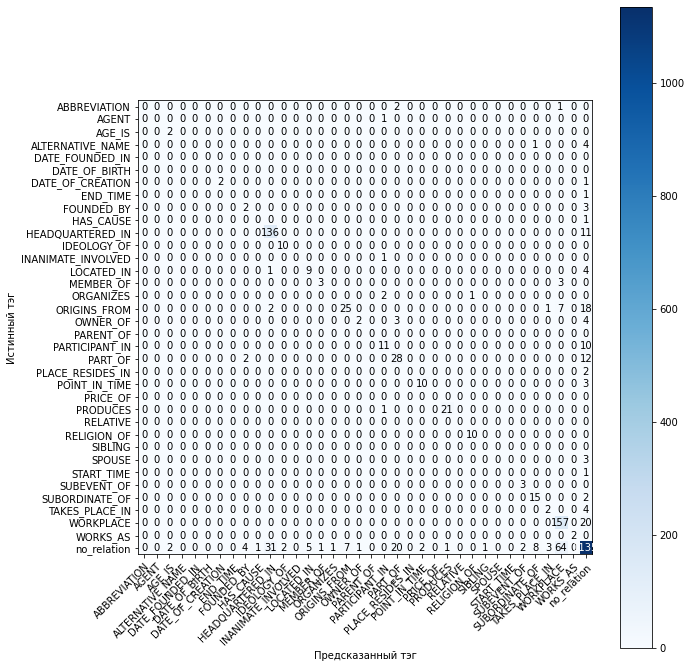

In [ ]:
model_DNN7.load_weights(model_save_path)

prob_predict = model_DNN7.predict([X_test3, test_subj0, test_obj0])
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

# Примеры по итоговой модели



In [ ]:
model_name = 'DNN8'
model_folder_path = '/content/drive/MyDrive/My_models/task2'
model_path = os.path.join(model_folder_path, model_name,'best_model.h5')

In [ ]:
import tensorflow as tf
from tensorflow import keras

In [ ]:
model_best = model_DNN7

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


                    precision    recall  f1-score   support

      ABBREVIATION       0.00      0.00      0.00         3
             AGENT       0.00      0.00      0.00         1
            AGE_IS       0.67      1.00      0.80         2
  ALTERNATIVE_NAME       0.00      0.00      0.00         5
  DATE_OF_CREATION       1.00      0.67      0.80         3
          END_TIME       1.00      1.00      1.00         1
        FOUNDED_BY       0.00      0.00      0.00         5
         HAS_CAUSE       0.00      0.00      0.00         1
  HEADQUARTERED_IN       0.81      0.97      0.88       147
       IDEOLOGY_OF       0.83      1.00      0.91        10
INANIMATE_INVOLVED       0.00      0.00      0.00         1
        LOCATED_IN       0.65      0.79      0.71        14
         MEMBER_OF       0.00      0.00      0.00         6
         ORGANIZES       1.00      0.33      0.50         3
      ORIGINS_FROM       0.65      0.62      0.63        53
          OWNER_OF       1.00      0.33

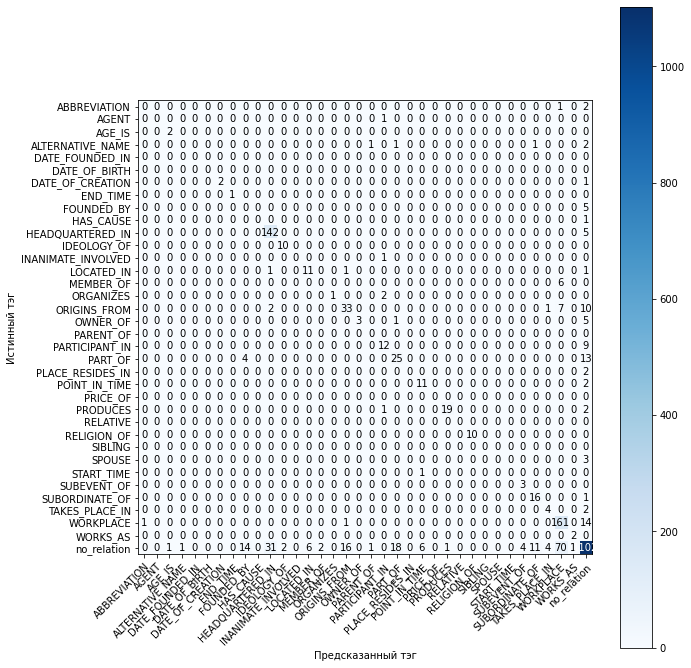

In [ ]:
# загрузим моедль и проверим


#model_best = DNN8(X_train3.shape[1])

#model_best.load_weights(model_path)

prob_predict = model_best.predict([X_test3, test_subj0, test_obj0])
test_predict = np.argmax(prob_predict, axis =1)
stat(y_test, test_predict)

In [ ]:
test_prob = model_best.predict([X_test3, test_subj0, test_obj0])
test_predict = np.argmax(test_prob, axis =1)

dev_prob = model_best.predict([X_dev3, dev_subj0, dev_obj0])
dev_predict = np.argmax(dev_prob, axis =1)

train_prob = model_best.predict([X_train3, train_subj0, train_obj0])
train_predict = np.argmax(train_prob, axis =1)

#stat(y_test, test_predict)

In [ ]:
all_predicts = np.concatenate((train_predict, dev_predict, test_predict))
all_probs = np.max(np.concatenate((train_prob, dev_prob, test_prob)), axis = 1)
all_y = np.concatenate((y_train, y_dev, y_test))

In [ ]:
all_data = train_data + dev_data + test_data

In [ ]:
true_labels = [labelEnc.inverse_transform([y])[0] for y in all_y]
predict_labels = [labelEnc.inverse_transform([y])[0] for y in all_predicts]

In [ ]:
test_predict[:6]

array([35, 35, 35, 35, 16, 35])

In [ ]:
# возьмем только для теста

test_predicts = np.concatenate((train_predict, dev_predict, test_predict))
test_probs = np.max(test_prob), axis = 1)
test_y = np.concatenate((y_train, y_dev, y_test))

true_labels_test = [labelEnc.inverse_transform([y])[0] for y in test_predict]
predict_labels = [labelEnc.inverse_transform([y])[0] for y in all_predicts]

In [ ]:
mistakes = [{'true': true, 'predict': pred, 'confidence_of_prediction': round(float(all_probs[i]), 3) , 'pair':all_data[i]} 
       for i, (true, pred) in enumerate(zip(true_labels, predict_labels)) if true != pred]

In [ ]:
test_preodicts

In [ ]:
mistakes = [{'true': true, 'predict': pred, 'confidence_of_prediction': round(float(all_probs[i]), 3) , 'pair':all_data[i]} 
       for i, (true, pred) in enumerate(zip(true_labels, predict_labels)) if true != pred]

In [ ]:
non_mistakes = [{'true': true, 'predict': pred, 'confidence_of_prediction': round(float(all_probs[i]), 3) , 'pair':all_data[i]} 
       for i, (true, pred) in enumerate(zip(true_labels, predict_labels)) if true == pred]

In [ ]:
non_mistakes[4]

{'confidence_of_prediction': 0.997,
 'pair': {'cover': 'российские власти',
  'cover_type': 'ORGANIZATION',
  'file': '18805_text',
  'obj': 'российские',
  'obj_type': 'COUNTRY',
  'rel': 'HEADQUARTERED_IN',
  'subj': 'российские власти',
  'subj_type': 'ORGANIZATION'},
 'predict': 'HEADQUARTERED_IN',
 'true': 'HEADQUARTERED_IN'}

In [ ]:
mistakes[0]

{'confidence_of_prediction': 0.702,
 'pair': {'cover': 'директором теплофизического центра Красноярского государственного технического университета',
  'cover_type': 'PROFESSION',
  'file': '20849_text',
  'obj': 'Красноярского государственного технического университета',
  'obj_type': 'ORGANIZATION',
  'rel': 'no_relation',
  'subj': 'директором теплофизического центра Красноярского государственного технического университета',
  'subj_type': 'PROFESSION'},
 'predict': 'WORKPLACE',
 'true': 'no_relation'}

In [ ]:
mistakes[-1]

{'confidence_of_prediction': 1.0,
 'pair': {'cover': 'первого зампреда ЦБ по вопросам денежно-кредитной политики',
  'cover_type': 'PROFESSION',
  'file': '1135',
  'obj': 'ЦБ',
  'obj_type': 'ORGANIZATION',
  'rel': 'WORKPLACE',
  'subj': 'первого зампреда ЦБ по вопросам денежно-кредитной политики',
  'subj_type': 'PROFESSION'},
 'predict': 'no_relation',
 'true': 'WORKPLACE'}

In [ ]:
folder = '/content/drive/MyDrive/My_models/task2/results'

In [ ]:
with open(os.path.join(folder, 'model_mistakes_finish.json'), 'w') as f:
  json.dump(mistakes, f)
with open(os.path.join(folder, 'non_mistakes_finish.json'), 'w') as f:
  json.dump(non_mistakes, f)

In [ ]:
with open(os.path.join(folder, 'test_predicts.json'), 'w') as f:
  json.dump(mistakes, f)

In [ ]:
with open(os.path.join(folder, 'model_mistakes_finish.json'), 'r') as f:
  mistakes0 = json.load(f)

In [ ]:
mistakes0[0]

{'confidence_of_prediction': 0.583,
 'pair': {'cover': 'российские власти',
  'cover_type': 'ORGANIZATION',
  'file': '18805_text',
  'obj': 'российские',
  'obj_type': 'COUNTRY',
  'rel': 'HEADQUARTERED_IN',
  'subj': 'российские власти',
  'subj_type': 'ORGANIZATION'},
 'predict': 'no_relation',
 'true': 'HEADQUARTERED_IN'}

In [ ]:
from ipymarkup import show_span_line_markup
import re

In [ ]:
ex = mistakes[0]
ex

{'confidence_of_prediction': 0.702,
 'pair': {'cover': 'директором теплофизического центра Красноярского государственного технического университета',
  'cover_type': 'PROFESSION',
  'file': '20849_text',
  'obj': 'Красноярского государственного технического университета',
  'obj_type': 'ORGANIZATION',
  'rel': 'no_relation',
  'subj': 'директором теплофизического центра Красноярского государственного технического университета',
  'subj_type': 'PROFESSION'},
 'predict': 'WORKPLACE',
 'true': 'no_relation'}

In [ ]:
text = ex['pair']['cover']
obj = ex['pair']['obj']
subj = ex['pair']['subj']
obj_span = re.search(obj, text).span()
obj_type = ex['pair']['obj_type']
subj_span = re.search(subj, text).span()
subj_type = ex['pair']['subj_type']

In [ ]:
spans = [(obj_span[0], obj_span[1], "Obj: "+obj_type), (subj_span[0], subj_span[1], "Subj: "+subj_type)]

In [ ]:
show_span_line_markup(text, spans)
print("Разметка:", ex['true'])
print("Предсказано:", ex['predict'])
print("Уверенность модели:", ex['confidence_of_prediction'])

Разметка: no_relation
Предсказано: WORKPLACE
Уверенность модели: 0.702


In [ ]:
def vis(ex):
  text = ex['pair']['cover']
  obj = ex['pair']['obj']
  subj = ex['pair']['subj']
  obj_span = re.search(obj, text).span()
  obj_type = ex['pair']['obj_type']
  subj_span = re.search(subj, text).span()
  subj_type = ex['pair']['subj_type']

  spans = [(obj_span[0], obj_span[1], "Obj: "+obj_type), (subj_span[0], subj_span[1], "Subj: "+subj_type)]

  show_span_line_markup(text, spans)
  print()
  print()
  print("Разметка:", ex['true'])
  print("Предсказано:", ex['predict'])
  print("Уверенность модели:", ex['confidence_of_prediction'])
  print('---------------------------------------------------------------')
  print()

In [ ]:
argsort_ind = np.argsort(np.array([ex['confidence_of_prediction'] for ex in mistakes]))

In [ ]:
mistakes_no_relation = [ex for ex in mistakes if ex['true'] == 'no_relation' or ex['predict'] == 'no_relation']

In [ ]:
with open(os.path.join(folder, 'mistakes_no_relation_finish.json'), 'w') as f:
  json.dump(mistakes_no_relation, f)

In [ ]:
for i in argsort_ind[:50]:
  vis(mistakes[i])



Разметка: no_relation
Предсказано: PRODUCES
Уверенность модели: 0.241
---------------------------------------------------------------





Разметка: no_relation
Предсказано: ALTERNATIVE_NAME
Уверенность модели: 0.263
---------------------------------------------------------------





Разметка: ORGANIZES
Предсказано: RELIGION_OF
Уверенность модели: 0.271
---------------------------------------------------------------





Разметка: ALTERNATIVE_NAME
Предсказано: no_relation
Уверенность модели: 0.337
---------------------------------------------------------------





Разметка: LOCATED_IN
Предсказано: no_relation
Уверенность модели: 0.343
---------------------------------------------------------------





Разметка: LOCATED_IN
Предсказано: no_relation
Уверенность модели: 0.344
---------------------------------------------------------------





Разметка: PART_OF
Предсказано: LOCATED_IN
Уверенность модели: 0.348
---------------------------------------------------------------





Разметка: OWNER_OF
Предсказано: no_relation
Уверенность модели: 0.348
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: WORKPLACE
Уверенность модели: 0.368
---------------------------------------------------------------





Разметка: OWNER_OF
Предсказано: no_relation
Уверенность модели: 0.378
---------------------------------------------------------------





Разметка: MEMBER_OF
Предсказано: no_relation
Уверенность модели: 0.387
---------------------------------------------------------------





Разметка: ABBREVIATION
Предсказано: PART_OF
Уверенность модели: 0.394
---------------------------------------------------------------





Разметка: ABBREVIATION
Предсказано: PART_OF
Уверенность модели: 0.394
---------------------------------------------------------------





Разметка: no_relation
Предсказано: WORKPLACE
Уверенность модели: 0.395
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: ORIGINS_FROM
Уверенность модели: 0.396
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: no_relation
Уверенность модели: 0.396
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: WORKPLACE
Уверенность модели: 0.397
---------------------------------------------------------------





Разметка: OWNER_OF
Предсказано: no_relation
Уверенность модели: 0.398
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: no_relation
Уверенность модели: 0.398
---------------------------------------------------------------





Разметка: no_relation
Предсказано: WORKPLACE
Уверенность модели: 0.4
---------------------------------------------------------------





Разметка: ALTERNATIVE_NAME
Предсказано: no_relation
Уверенность модели: 0.401
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: no_relation
Уверенность модели: 0.403
---------------------------------------------------------------





Разметка: no_relation
Предсказано: WORKPLACE
Уверенность модели: 0.405
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: no_relation
Уверенность модели: 0.408
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: no_relation
Уверенность модели: 0.411
---------------------------------------------------------------





Разметка: no_relation
Предсказано: WORKPLACE
Уверенность модели: 0.414
---------------------------------------------------------------





Разметка: no_relation
Предсказано: WORKPLACE
Уверенность модели: 0.414
---------------------------------------------------------------





Разметка: PART_OF
Предсказано: no_relation
Уверенность модели: 0.415
---------------------------------------------------------------





Разметка: no_relation
Предсказано: PART_OF
Уверенность модели: 0.415
---------------------------------------------------------------





Разметка: PART_OF
Предсказано: no_relation
Уверенность модели: 0.415
---------------------------------------------------------------





Разметка: no_relation
Предсказано: PART_OF
Уверенность модели: 0.415
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: no_relation
Уверенность модели: 0.416
---------------------------------------------------------------





Разметка: no_relation
Предсказано: ORIGINS_FROM
Уверенность модели: 0.418
---------------------------------------------------------------





Разметка: OWNER_OF
Предсказано: no_relation
Уверенность модели: 0.419
---------------------------------------------------------------





Разметка: no_relation
Предсказано: LOCATED_IN
Уверенность модели: 0.419
---------------------------------------------------------------





Разметка: no_relation
Предсказано: SIBLING
Уверенность модели: 0.422
---------------------------------------------------------------





Разметка: FOUNDED_BY
Предсказано: PART_OF
Уверенность модели: 0.427
---------------------------------------------------------------





Разметка: HEADQUARTERED_IN
Предсказано: no_relation
Уверенность модели: 0.43
---------------------------------------------------------------





Разметка: no_relation
Предсказано: WORKPLACE
Уверенность модели: 0.431
---------------------------------------------------------------





Разметка: no_relation
Предсказано: ABBREVIATION
Уверенность модели: 0.432
---------------------------------------------------------------





Разметка: MEMBER_OF
Предсказано: no_relation
Уверенность модели: 0.435
---------------------------------------------------------------





Разметка: no_relation
Предсказано: OWNER_OF
Уверенность модели: 0.437
---------------------------------------------------------------





Разметка: no_relation
Предсказано: WORKPLACE
Уверенность модели: 0.441
---------------------------------------------------------------





Разметка: no_relation
Предсказано: WORKPLACE
Уверенность модели: 0.442
---------------------------------------------------------------





Разметка: no_relation
Предсказано: HEADQUARTERED_IN
Уверенность модели: 0.448
---------------------------------------------------------------





Разметка: no_relation
Предсказано: HEADQUARTERED_IN
Уверенность модели: 0.448
---------------------------------------------------------------





Разметка: MEMBER_OF
Предсказано: WORKPLACE
Уверенность модели: 0.448
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: no_relation
Уверенность модели: 0.448
---------------------------------------------------------------





Разметка: no_relation
Предсказано: ORIGINS_FROM
Уверенность модели: 0.45
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: no_relation
Уверенность модели: 0.45
---------------------------------------------------------------



In [ ]:
for i in argsort_ind[-50:]:
  vis(mistakes[i])



Разметка: no_relation
Предсказано: WORKPLACE
Уверенность модели: 0.99
---------------------------------------------------------------





Разметка: no_relation
Предсказано: WORKPLACE
Уверенность модели: 0.99
---------------------------------------------------------------





Разметка: no_relation
Предсказано: WORKPLACE
Уверенность модели: 0.991
---------------------------------------------------------------





Разметка: no_relation
Предсказано: HEADQUARTERED_IN
Уверенность модели: 0.991
---------------------------------------------------------------





Разметка: SUBORDINATE_OF
Предсказано: no_relation
Уверенность модели: 0.992
---------------------------------------------------------------





Разметка: PART_OF
Предсказано: no_relation
Уверенность модели: 0.993
---------------------------------------------------------------





Разметка: SPOUSE
Предсказано: no_relation
Уверенность модели: 0.993
---------------------------------------------------------------





Разметка: SPOUSE
Предсказано: no_relation
Уверенность модели: 0.993
---------------------------------------------------------------





Разметка: no_relation
Предсказано: ORIGINS_FROM
Уверенность модели: 0.993
---------------------------------------------------------------





Разметка: MEMBER_OF
Предсказано: no_relation
Уверенность модели: 0.994
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: no_relation
Уверенность модели: 0.994
---------------------------------------------------------------





Разметка: OWNER_OF
Предсказано: no_relation
Уверенность модели: 0.994
---------------------------------------------------------------





Разметка: no_relation
Предсказано: HEADQUARTERED_IN
Уверенность модели: 0.995
---------------------------------------------------------------





Разметка: no_relation
Предсказано: WORKPLACE
Уверенность модели: 0.995
---------------------------------------------------------------





Разметка: PART_OF
Предсказано: no_relation
Уверенность модели: 0.995
---------------------------------------------------------------





Разметка: TAKES_PLACE_IN
Предсказано: no_relation
Уверенность модели: 0.995
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: no_relation
Уверенность модели: 0.996
---------------------------------------------------------------





Разметка: PART_OF
Предсказано: no_relation
Уверенность модели: 0.996
---------------------------------------------------------------





Разметка: WORKS_AS
Предсказано: no_relation
Уверенность модели: 0.996
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: no_relation
Уверенность модели: 0.996
---------------------------------------------------------------





Разметка: no_relation
Предсказано: ORIGINS_FROM
Уверенность модели: 0.996
---------------------------------------------------------------





Разметка: SUBEVENT_OF
Предсказано: no_relation
Уверенность модели: 0.997
---------------------------------------------------------------





Разметка: no_relation
Предсказано: WORKPLACE
Уверенность модели: 0.997
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: HEADQUARTERED_IN
Уверенность модели: 0.997
---------------------------------------------------------------





Разметка: HEADQUARTERED_IN
Предсказано: no_relation
Уверенность модели: 0.997
---------------------------------------------------------------





Разметка: LOCATED_IN
Предсказано: no_relation
Уверенность модели: 0.998
---------------------------------------------------------------





Разметка: WORKS_AS
Предсказано: no_relation
Уверенность модели: 0.998
---------------------------------------------------------------





Разметка: WORKS_AS
Предсказано: no_relation
Уверенность модели: 0.998
---------------------------------------------------------------





Разметка: PLACE_RESIDES_IN
Предсказано: no_relation
Уверенность модели: 0.998
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: no_relation
Уверенность модели: 0.999
---------------------------------------------------------------





Разметка: POINT_IN_TIME
Предсказано: no_relation
Уверенность модели: 0.999
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: no_relation
Уверенность модели: 0.999
---------------------------------------------------------------





Разметка: no_relation
Предсказано: HEADQUARTERED_IN
Уверенность модели: 0.999
---------------------------------------------------------------





Разметка: no_relation
Предсказано: HEADQUARTERED_IN
Уверенность модели: 0.999
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: no_relation
Уверенность модели: 0.999
---------------------------------------------------------------





Разметка: PARTICIPANT_IN
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: POINT_IN_TIME
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: WORKS_AS
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: PARTICIPANT_IN
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: PARTICIPANT_IN
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: WORKS_AS
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: PARTICIPANT_IN
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: PARTICIPANT_IN
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------



In [ ]:
for i in range(50):
  vis(choice(non_mistakes))



Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.959
---------------------------------------------------------------





Разметка: FOUNDED_BY
Предсказано: FOUNDED_BY
Уверенность модели: 0.884
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: WORKPLACE
Уверенность модели: 0.957
---------------------------------------------------------------





Разметка: HEADQUARTERED_IN
Предсказано: HEADQUARTERED_IN
Уверенность модели: 0.913
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.708
---------------------------------------------------------------





Разметка: OWNER_OF
Предсказано: OWNER_OF
Уверенность модели: 0.44
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.963
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.919
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: WORKPLACE
Уверенность модели: 0.87
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.998
---------------------------------------------------------------





Разметка: HEADQUARTERED_IN
Предсказано: HEADQUARTERED_IN
Уверенность модели: 0.954
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: WORKPLACE
Уверенность модели: 0.547
---------------------------------------------------------------





Разметка: HEADQUARTERED_IN
Предсказано: HEADQUARTERED_IN
Уверенность модели: 0.895
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.999
---------------------------------------------------------------





Разметка: POINT_IN_TIME
Предсказано: POINT_IN_TIME
Уверенность модели: 0.91
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: WORKPLACE
Уверенность модели: 0.8
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: WORKPLACE
Уверенность модели: 0.927
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.998
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.997
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.979
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.991
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.955
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.81
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.999
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: WORKPLACE
Уверенность модели: 0.852
---------------------------------------------------------------





Разметка: PRODUCES
Предсказано: PRODUCES
Уверенность модели: 0.998
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.908
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.993
---------------------------------------------------------------





Разметка: HEADQUARTERED_IN
Предсказано: HEADQUARTERED_IN
Уверенность модели: 0.984
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.971
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.976
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: WORKPLACE
Уверенность модели: 0.944
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: WORKPLACE
Уверенность модели: 0.876
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: WORKPLACE
Уверенность модели: 0.847
---------------------------------------------------------------





Разметка: ORIGINS_FROM
Предсказано: ORIGINS_FROM
Уверенность модели: 0.947
---------------------------------------------------------------





Разметка: IDEOLOGY_OF
Предсказано: IDEOLOGY_OF
Уверенность модели: 0.954
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: WORKPLACE
Уверенность модели: 0.438
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.952
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.963
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 1.0
---------------------------------------------------------------





Разметка: WORKPLACE
Предсказано: WORKPLACE
Уверенность модели: 0.947
---------------------------------------------------------------





Разметка: no_relation
Предсказано: no_relation
Уверенность модели: 0.988
---------------------------------------------------------------

